<a href="https://colab.research.google.com/github/UgurUysal86/MLS4MIL/blob/master/Image%20Classification/code/5RuTanks7000_v1_EfficientNetB4_public.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# [Ugur Uysal](https://www.credential.net/63d59900-d68b-4b59-aaef-b2e93cd45c41) - ugur.uysal.86@gmail.com - 31. JUL 2020

**5RuTanks7000_v1 Dataset**, described by the GitHub Repository [Machine Learning and Simulation for Military Applications](https://github.com/UgurUysal86/MLS4MIL/tree/master/Image%20Classification) 

Except for class "Civilian Car" which was adapted from [Cars Dataset](https://ai.stanford.edu/~jkrause/cars/car_dataset.html) all training images (7000 per class) were created synthetically with the game engine [Arma3](https://arma3.com/). The 105 test images are real images publicly available and provided under creative commons licenses. A full reference of all Test Images is provided in the GitHub Repository above. 


In [ ]:
import tensorflow as tf
print("Using Tensorflow Version", tf.__version__, "\n")

# validating COLAB GPU
from tensorflow.python.client import device_lib
for x in device_lib.list_local_devices():
   if x.device_type == "GPU":
     print("***** GPU Information *****")
     print("Device Name: " , x.name)
     print("Memory Limit: " , "%.2f" % float(x.memory_limit/(1000*1000*1000)), "GB")
     print("Description: " , x.physical_device_desc)

gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
print(gpu_info)

Using Tensorflow Version 2.2.0 

***** GPU Information *****
Device Name:  /device:GPU:0
Memory Limit:  15.70 GB
Description:  device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0
Fri Jul 31 08:16:00 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.51.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P0    34W / 250W |    353MiB / 16280MiB |      0%      Default |
|                               

Downloading the "5RuTanks7000_v1" Dataset from OneDrive as zipfile and saving temporary in Colab

In [ ]:
!wget --no-check-certificate \
    "https://onedrive.live.com/download?cid=D57BE18797CC43E3&resid=D57BE18797CC43E3%21511654&authkey=AJq_8Esq8bsTl1o" \
    -O /tmp/5RuTanks7000_v1.zip
 
import zipfile
print ("Loading dataset ...")
local_zip = '/tmp/5RuTanks7000_v1.zip'
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('/tmp/')
zip_ref.close()
print ("Dataset successfully loaded and unzipped")
 
# Settings paths
dataset_path = '/tmp/5RuTanks7000_v1/'

--2020-07-31 08:16:03--  https://onedrive.live.com/download?cid=D57BE18797CC43E3&resid=D57BE18797CC43E3%21511654&authkey=AJq_8Esq8bsTl1o
Resolving onedrive.live.com (onedrive.live.com)... 13.107.42.13
Connecting to onedrive.live.com (onedrive.live.com)|13.107.42.13|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://4zlp6g.dm.files.1drv.com/y4m9xd9l9_iV3XdF-R52wlniLB8NeFs2uQtzZUQbpPVqZlWpXkAgn5dYxY8U0lfkPPF6Ua4FHl8ksrzjbCxrwSiAoKYX1NTFWxbneQEwLh0ggBCc9MesD5MfOzI0Y9BMCF30OSt3ReW2edAlrlGszQV8tDpeipDynvk_OLoDoZXt3ZAPHVAat9D4STwHYC4mJ1_DoACB914rycef_oFg-t6DA/5RuTanks7000_v1.zip?download&psid=1 [following]
--2020-07-31 08:16:03--  https://4zlp6g.dm.files.1drv.com/y4m9xd9l9_iV3XdF-R52wlniLB8NeFs2uQtzZUQbpPVqZlWpXkAgn5dYxY8U0lfkPPF6Ua4FHl8ksrzjbCxrwSiAoKYX1NTFWxbneQEwLh0ggBCc9MesD5MfOzI0Y9BMCF30OSt3ReW2edAlrlGszQV8tDpeipDynvk_OLoDoZXt3ZAPHVAat9D4STwHYC4mJ1_DoACB914rycef_oFg-t6DA/5RuTanks7000_v1.zip?download&psid=1
Resolving 4zlp6g.dm.files.1drv.com (4zlp6g.d

Visualizing random images of the 5RuTanks7000_v1 dataset 

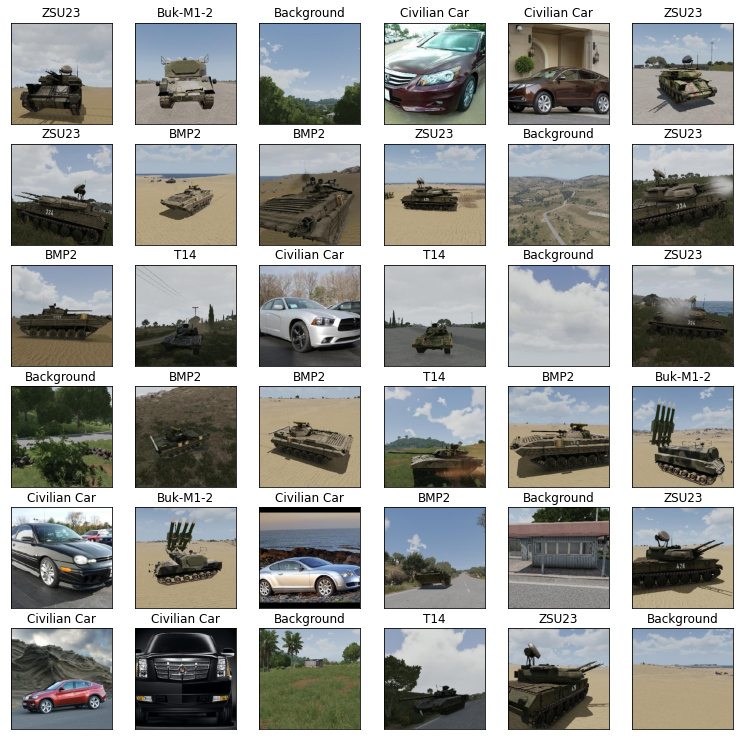

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np

classnames = ["Background", "BMP2", "Buk-M1-2", "Civilian Car", "T14", "T90","ZSU23"]

samples = []
for i in range(36):
  rnd_class = np.random.randint(7, size=1) 
  rnd_img = np.random.randint(7000, size=1) 
  img = '/tmp/5RuTanks7000_v1/train/'+classnames[rnd_class[0]]+'/'+classnames[rnd_class[0]]+'_'+str(rnd_img[0])+'.jpg'
  samples.append(img)

plt.figure(figsize=(13,13))
for i in range(len(samples)):
    plt.subplot(6,6,i+1)
    plt.imshow(mpimg.imread(samples[i]))
    plt.grid(None)
    plt.xticks([])
    plt.yticks([])
    if classnames[0] in samples[i]:plt.title(classnames[0])
    if classnames[1] in samples[i]:plt.title(classnames[1])
    if classnames[2] in samples[i]:plt.title(classnames[2])
    if classnames[3] in samples[i]:plt.title(classnames[3])
    if classnames[4] in samples[i]:plt.title(classnames[4])
    if classnames[5] in samples[i]:plt.title(classnames[5])
    if classnames[6] in samples[i]:plt.title(classnames[6])
plt.show()

Setting Parameters

In [ ]:
import os
img_height,img_width = 331, 331

nbrTrainImages = 0  # Value gets accurate after counting (Total Number of train images)
for ImagesClass in os.listdir(dataset_path+'train/'):
    nbrTrainImages += len(os.listdir(dataset_path+'train/'+ImagesClass))
print(nbrTrainImages, "train images loaded")

nbrTestImages = 0  # Value gets accurate after counting (Total Number of test images)
for ImagesClass in os.listdir(dataset_path+'test/'):
    nbrTestImages += len(os.listdir(dataset_path+'test/'+ImagesClass))
print(nbrTestImages, "test images loaded")

# hyperparameters
max_epochs = 250
learning_rate = 0.000025
batch = 16
dropout = 0.5
fcLayer1 = 32
patience = 5
factor = 0.5
verbose_train = 2
print("Training parameters set")

49000 train images loaded
105 test images loaded
Training parameters set


Loading the pretrained model EfficientNetB4 (https://github.com/tensorflow/tpu/tree/master/models/official/efficientnet) as conv_base

In [ ]:
!pip install efficientnet
import efficientnet.tfkeras as efn 
conv_base = efn.EfficientNetB4(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))
conv_base.summary()
print ("\ntrainable layers of the base network: ",int(len(conv_base.trainable_weights) / 2))

Model: "efficientnet-b4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 331, 331, 3) 0                                            
__________________________________________________________________________________________________
stem_conv (Conv2D)              (None, 166, 166, 48) 1296        input_1[0][0]                    
__________________________________________________________________________________________________
stem_bn (BatchNormalization)    (None, 166, 166, 48) 192         stem_conv[0][0]                  
__________________________________________________________________________________________________
stem_activation (Activation)    (None, 166, 166, 48) 0           stem_bn[0][0]                    
____________________________________________________________________________________

Creating Datagenerators with Data Augmentation https://keras.io/preprocessing/image/

In [ ]:
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    preprocessing_function=efn.preprocess_input,                                                                                                                
    rotation_range=10,
    width_shift_range=0.10,
    height_shift_range=0.10,
    zoom_range=0.10,
    brightness_range=[0.5, 1.5],
    fill_mode='nearest',
    horizontal_flip=True)
train_generator = train_datagen.flow_from_directory(
    dataset_path+'train',
    target_size=(img_height, img_width),
    batch_size=batch,
    shuffle=True,
    classes=classnames,
    class_mode='categorical')

test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(preprocessing_function=efn.preprocess_input)
test_generator = test_datagen.flow_from_directory(
    dataset_path+'test',
    target_size=(img_height, img_width),
    batch_size=1,
    shuffle=False,
    classes=classnames,
    class_mode='categorical')

Found 49000 images belonging to 7 classes.
Found 105 images belonging to 7 classes.


# Part 1: Training the model https://keras.io/guides/transfer_learning/



In [ ]:
# freezing the base network
conv_base.trainable = False

# Building the model using the pretrained model
inputs = tf.keras.Input(shape=(img_height, img_width, 3))
x = conv_base(inputs, training=False)
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dropout(dropout)(x)
x = tf.keras.layers.Dense(fcLayer1, activation=tf.nn.relu)(x)
x = tf.keras.layers.BatchNormalization()(x)
outputs = tf.keras.layers.Dense(len(classnames), activation=tf.nn.softmax)(x)
model = tf.keras.Model(inputs, outputs)

print("trainable layers after freezing the base network:", int(len(model.trainable_weights)/2))
print("\npretrained network + densely connected classifier")
model.summary()

model.compile(loss=tf.keras.losses.categorical_crossentropy, optimizer=tf.keras.optimizers.RMSprop(lr=learning_rate), metrics=['acc'])

callbacks_L1 = [tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0, patience=(patience*2)+1, verbose=1, mode='auto', baseline=None, restore_best_weights=True),
                tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=factor, patience=patience, verbose=1)]

print("\n### Level 1 Training ... ")
history_L1 = model.fit(
    train_generator,
    steps_per_epoch=nbrTrainImages // (batch * 50),
    epochs=max_epochs,
    callbacks=callbacks_L1,
    validation_data=test_generator,
    validation_steps=nbrTestImages,
    verbose=verbose_train)

print("\n### Level 1 Training finished successfully ###")

trainable layers after freezing the base network: 3

pretrained network + densely connected classifier
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 331, 331, 3)]     0         
_________________________________________________________________
efficientnet-b4 (Model)      (None, 11, 11, 1792)      17673816  
_________________________________________________________________
global_average_pooling2d (Gl (None, 1792)              0         
_________________________________________________________________
dropout (Dropout)            (None, 1792)              0         
_________________________________________________________________
dense (Dense)                (None, 32)                57376     
_________________________________________________________________
batch_normalization (BatchNo (None, 32)                128       
________________________

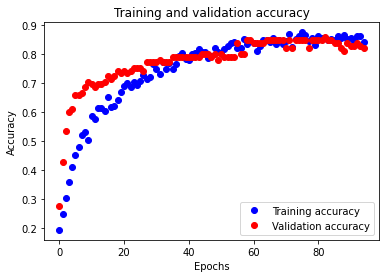

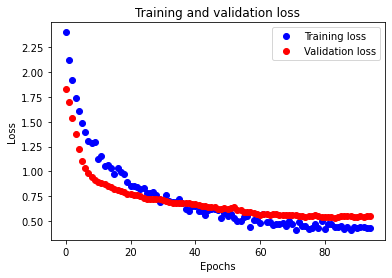

In [ ]:
# Evaluating Accuracy and Loss for the model for Level 1 Training
acc      = history_L1.history['acc']
val_acc  = history_L1.history['val_acc']
loss     = history_L1.history['loss' ]
val_loss = history_L1.history['val_loss']
epochs   = range(len(acc)) # Get number of epochs

# Plot training and validation accuracy per epoch
plt.plot(epochs, acc, 'bo', label='Training accuracy')
plt.plot(epochs, val_acc, 'ro', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# Plot training and validation loss per epoch
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'ro', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
# unfreezing the base network up to a specific layer:
freezeUptoLayer = ""   # efficientnet min "block2a_expand_conv" max "block7d_expand_conv" 

if freezeUptoLayer == "":
    conv_base.trainable = True
    print ("\ntrainable layers: ",int(len(model.trainable_weights) / 2))
else:
    print("\ntrainable layers before unfreezing the base network up from " + freezeUptoLayer + ": ",int(len(model.trainable_weights) / 2))  # weights = weights + bias = 2 pro layer
    conv_base.trainable = True
    set_trainable = False
    for layer in conv_base.layers:
        if layer.name == freezeUptoLayer: set_trainable = True
        if set_trainable: layer.trainable = True
        else: layer.trainable = False
    print("trainable layers after unfreezing the base network up from " + freezeUptoLayer + ": ", int(len(model.trainable_weights)/2))

model.compile(loss=tf.keras.losses.categorical_crossentropy, optimizer=tf.keras.optimizers.RMSprop(lr=learning_rate/2), metrics=['acc'])

print('\nvalidating model before training unfreezed layers and trained densely connected layers:')
val_loss, val_acc = model.evaluate(test_generator, steps=nbrTestImages, verbose=1)
print('Validation loss:',val_loss,",",'Validation accuracy:', val_acc, "\n")

callbacks_L2 = [tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0, patience=(patience*2)+1, verbose=1, mode='auto', baseline=None, restore_best_weights=True),
                tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=factor, patience=patience, verbose=1)]

print("\n### Level 2 Training (Fine-Tuning) ... ")
history_L2 = model.fit(
    train_generator,
    steps_per_epoch=nbrTrainImages // (batch * 50),
    epochs=max_epochs,
    callbacks=callbacks_L2,
    validation_data=test_generator,
    validation_steps=nbrTestImages,
    verbose=verbose_train)

print("\n### Level 2 Training (Fine-Tuning) finished successfully ###")


trainable layers:  211

validating model before training unfreezed layers and trained densely connected layers:
105/105 [==============================] - 2s 20ms/step - loss: 0.5372 - acc: 0.8476
Validation loss: 0.5371819138526917 , Validation accuracy: 0.8476190567016602 


### Level 2 Training (Fine-Tuning) ... 
Epoch 1/250
61/61 - 39s - loss: 0.3507 - acc: 0.9006 - val_loss: 0.4211 - val_acc: 0.8667 - lr: 1.2500e-05
Epoch 2/250
61/61 - 39s - loss: 0.2440 - acc: 0.9385 - val_loss: 0.4237 - val_acc: 0.8857 - lr: 1.2500e-05
Epoch 3/250
61/61 - 39s - loss: 0.2067 - acc: 0.9488 - val_loss: 0.3700 - val_acc: 0.8952 - lr: 1.2500e-05
Epoch 4/250
61/61 - 39s - loss: 0.1621 - acc: 0.9652 - val_loss: 0.3206 - val_acc: 0.9238 - lr: 1.2500e-05
Epoch 5/250
61/61 - 39s - loss: 0.1205 - acc: 0.9785 - val_loss: 0.3031 - val_acc: 0.9429 - lr: 1.2500e-05
Epoch 6/250
61/61 - 39s - loss: 0.1084 - acc: 0.9816 - val_loss: 0.3153 - val_acc: 0.9048 - lr: 1.2500e-05
Epoch 7/250
61/61 - 39s - loss: 0.0978 

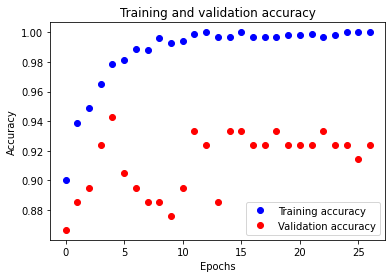

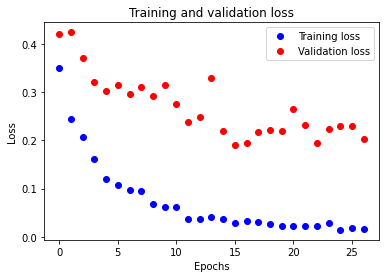

In [ ]:
# Evaluating Accuracy and Loss for the model for Level 1 Training
acc      = history_L2.history['acc']
val_acc  = history_L2.history['val_acc']
loss     = history_L2.history['loss' ]
val_loss = history_L2.history['val_loss']
epochs   = range(len(acc)) # Get number of epochs

# Plot training and validation accuracy per epoch
plt.plot(epochs, acc, 'bo', label='Training accuracy')
plt.plot(epochs, val_acc, 'ro', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# Plot training and validation loss per epoch
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'ro', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

Save and download the trained model

In [ ]:
from google.colab import files
model.save('this_model') 
saved_model = tf.keras.models.load_model('this_model')
saved_model.summary()
tf.keras.models.save_model(saved_model, '5RuTanks7000_v1_EfficientNetB4_public.h5')
files.download('5RuTanks7000_v1_EfficientNetB4_public.h5')

# Destroying the current TF graph - https://keras.io/backend/
tf.keras.backend.clear_session()

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: this_model/assets
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 331, 331, 3)]     0         
_________________________________________________________________
efficientnet-b4 (Model)      (None, 11, 11, 1792)      17673816  
_________________________________________________________________
global_average_pooling2d (Gl (None, 1792)              0         
_________________________________________________________________
dropout (Dropout)            (None, 1792)              0         
_________________________________________________________________
dense (Dense)                (None, 32)                57376     
_________________________________________________________________
batch_normalization (BatchNo (None, 32)                128 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Part 2: Analyzing the trained model:

Saving test images and true labes

In [ ]:
test_images_path = []
true_labels = []
true_labels_class = []

test_images_Background = os.listdir(dataset_path +'test/Background/')
for imagefile in test_images_Background:
    test_images_path.append(dataset_path +'test/Background/' + imagefile)
    true_labels.append(0)
    true_labels_class.append('Background')

test_images_BMP2 = os.listdir(dataset_path +'test/BMP2/')
for imagefile in test_images_BMP2:
    test_images_path.append(dataset_path +'test/BMP2/' + imagefile)
    true_labels.append(1)
    true_labels_class.append('BMP2')

test_images_Buk = os.listdir(dataset_path +'test/Buk-M1-2/')
for imagefile in test_images_Buk:
    test_images_path.append(dataset_path +'test/Buk-M1-2/' + imagefile)
    true_labels.append(2)
    true_labels_class.append('Buk-M1-2')

test_images_CivCar = os.listdir(dataset_path +'test/Civilian Car/')
for imagefile in test_images_CivCar:
    test_images_path.append(dataset_path +'test/Civilian Car/' + imagefile)
    true_labels.append(3)
    true_labels_class.append('Civilian Car')

test_images_T14 = os.listdir(dataset_path +'test/T14/')
for imagefile in test_images_T14:
    test_images_path.append(dataset_path +'test/T14/' + imagefile)
    true_labels.append(4)
    true_labels_class.append('T14')

test_images_T90 = os.listdir(dataset_path +'test/T90/')
for imagefile in test_images_T90:
    test_images_path.append(dataset_path +'test/T90/' + imagefile)
    true_labels.append(5)
    true_labels_class.append('T90')

test_images_ZSU23 = os.listdir(dataset_path +'test/ZSU23/')
for imagefile in test_images_ZSU23:
    test_images_path.append(dataset_path +'test/ZSU23/' + imagefile)
    true_labels.append(6)
    true_labels_class.append('ZSU23')

print(len(test_images_path), "test images paths successfully saved")

105 test images paths successfully saved


predicting labels of test images with best trained model

In [ ]:
print("\n### Testing the saved model ... ")
test_loss, test_acc = saved_model.evaluate(test_generator, steps=nbrTestImages, verbose=1)
print('Test Results of the trained Model:\nTest loss:', test_loss, ",", 'test accuracy:', test_acc)

print("\n### predicting labels of the test set with the loaded model ... ")
pred_labels = []
img_tensors = []
for file in test_images_path:
    img = tf.keras.preprocessing.image.load_img(file, target_size=(img_height, img_width))
    img_tensor = tf.keras.preprocessing.image.img_to_array(img)
    img_tensor = np.expand_dims(img_tensor, axis=0)
    img_tensor = efn.preprocess_input(img_tensor)
    img_tensors.append(img_tensor)
    pred_labels.append(saved_model.predict(img_tensor))

print(len(pred_labels), "predicted labels generated succesfully")
print(len(img_tensors), "image tensors generated succesfully")


### Testing the saved model ... 
105/105 [==============================] - 2s 21ms/step - loss: 0.1899 - acc: 0.9333
Test Results of the trained Model:
Test loss: 0.18989689648151398 , test accuracy: 0.9333333373069763

### predicting labels of the test set with the loaded model ... 
105 predicted labels generated succesfully
105 image tensors generated succesfully


Calculating classification report, confusion_matrix, and t-Distributed Stochastic Neighbor Embedding (https://www.datacamp.com/community/tutorials/introduction-t-sne)

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm



Confusion Matrix
[[15  0  0  0  0  0  0]
 [ 0 14  0  0  1  0  0]
 [ 0  0 15  0  0  0  0]
 [ 0  0  0 15  0  0  0]
 [ 0  0  0  0 11  4  0]
 [ 0  1  0  0  0 14  0]
 [ 0  0  1  0  0  0 14]]

Classification Report
              precision    recall  f1-score   support

  Background       1.00      1.00      1.00        15
        BMP2       0.93      0.93      0.93        15
    Buk-M1-2       0.94      1.00      0.97        15
Civilian Car       1.00      1.00      1.00        15
         T14       0.92      0.73      0.81        15
         T90       0.78      0.93      0.85        15
       ZSU23       1.00      0.93      0.97        15

    accuracy                           0.93       105
   macro avg       0.94      0.93      0.93       105
weighted avg       0.94      0.93      0.93       105

img_tensors.shape= (105, 331, 331, 3)
activations.shape= (105, 7)

 t-Distributed Stochastic Neighbor Embedding


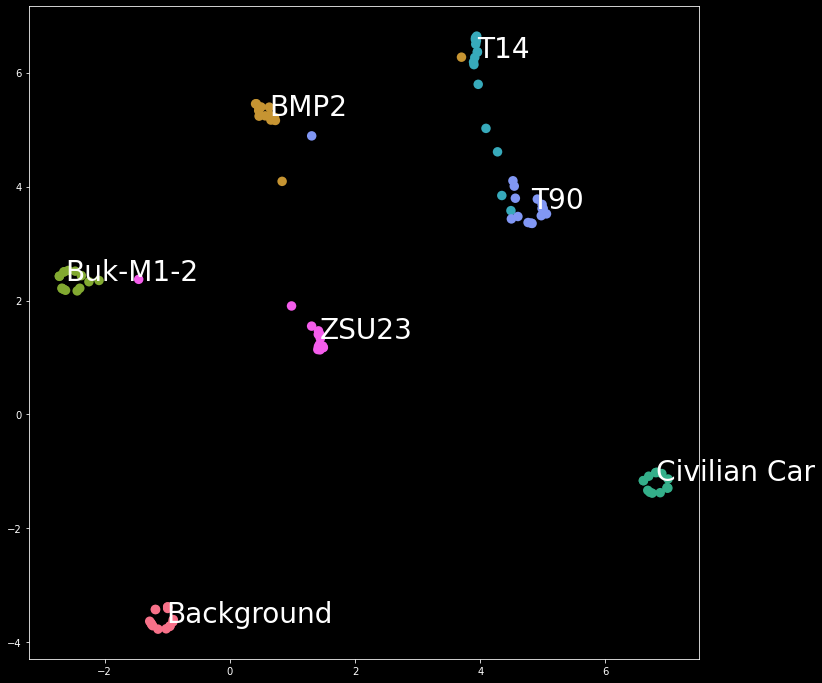

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.manifold import TSNE
import seaborn as sns

# Confusion Matrix and Classification Report
print('\nConfusion Matrix')
print(confusion_matrix(true_labels, np.argmax(pred_labels, axis=-1)))
print('\nClassification Report')
print(classification_report(true_labels, np.argmax(pred_labels, axis=-1), target_names=classnames))

# t-SNE Visualization: t-Distributed Stochastic Neighbor Embedding (t-SNE) for visualizing high-dimensional data.
layer = model.get_layer(index=len(model.layers)-1) # get last layer by index, use model.get_layer('dense_1') to get last layer by string.
layer_output = layer.output
activation_model = tf.keras.models.Model(inputs=model.input, outputs=[layer_output])

img_tensors = np.array(img_tensors) 
img_tensors = np.concatenate(img_tensors)
print("img_tensors.shape=", img_tensors.shape)

activations = activation_model.predict(img_tensors)
print("activations.shape=", activations.shape)

print("\n t-Distributed Stochastic Neighbor Embedding") 
tsne = TSNE(random_state=86).fit_transform(activations)

# Visualization of the feature vectors produce by the convnet
palette = np.array(sns.color_palette("husl", len(classnames)))
true_labels = np.array(true_labels)

# create a scatter plot.
fig = plt.figure(figsize=(12, 12))
fig.patch.set_facecolor('black')
plt.style.use('dark_background')
plt.scatter(tsne[:, 0], tsne[:, 1], lw=0, s=90, c=palette[true_labels])
plt.axis('tight')

txts = []
for j in range(len(classnames)):
    # Position of each label at median of data points.
    xtext, ytext = np.median(tsne[true_labels == j, :], axis=0)
    txt = plt.text(xtext, ytext, classnames[j], fontsize=28, color = 'w')
    txts.append(txt)
plt.show()

# Plotting all test images with class predictions as title


Class Predictions of test images from /tmp/5RuTanks7000_v1/test/

 Image 1 : [(99.35, 'Background'), (0.2, 'BMP2'), (0.15, 'Civilian Car'), (0.13, 'ZSU23'), (0.07, 'Buk-M1-2'), (0.06, 'T90'), (0.04, 'T14')]


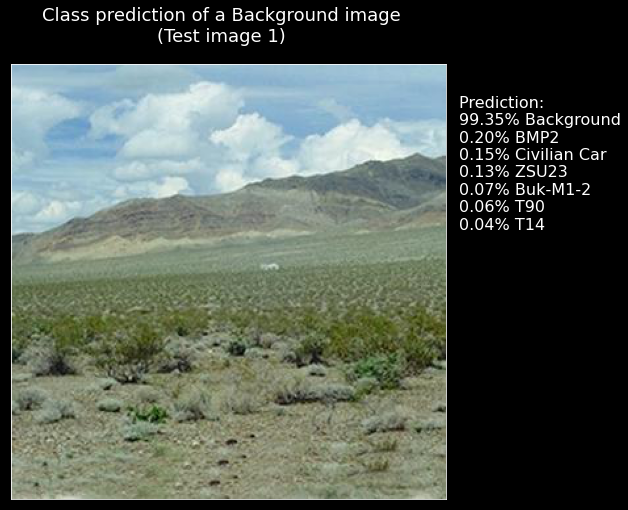


 Image 2 : [(99.66, 'Background'), (0.18, 'Civilian Car'), (0.06, 'T14'), (0.04, 'BMP2'), (0.03, 'ZSU23'), (0.02, 'Buk-M1-2'), (0.01, 'T90')]


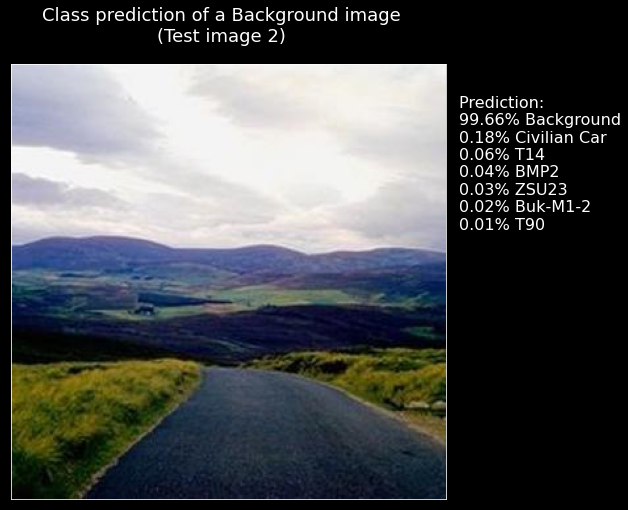


 Image 3 : [(99.92, 'Background'), (0.03, 'Civilian Car'), (0.02, 'T14'), (0.01, 'ZSU23'), (0.01, 'T90'), (0.0, 'Buk-M1-2'), (0.0, 'BMP2')]


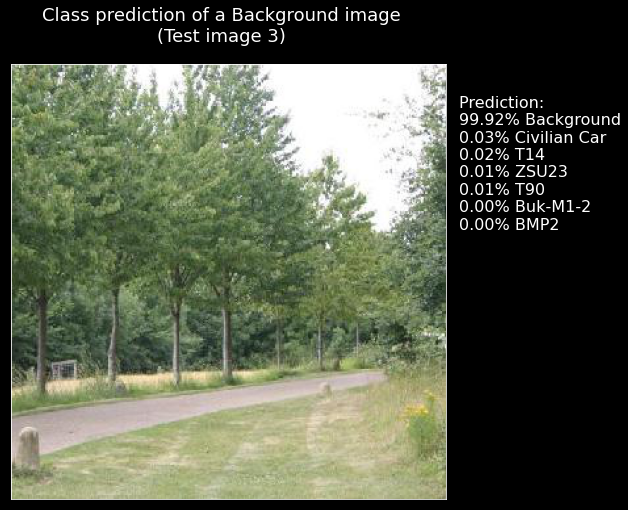


 Image 4 : [(99.88, 'Background'), (0.05, 'Civilian Car'), (0.02, 'BMP2'), (0.01, 'ZSU23'), (0.01, 'T90'), (0.01, 'T14'), (0.01, 'Buk-M1-2')]


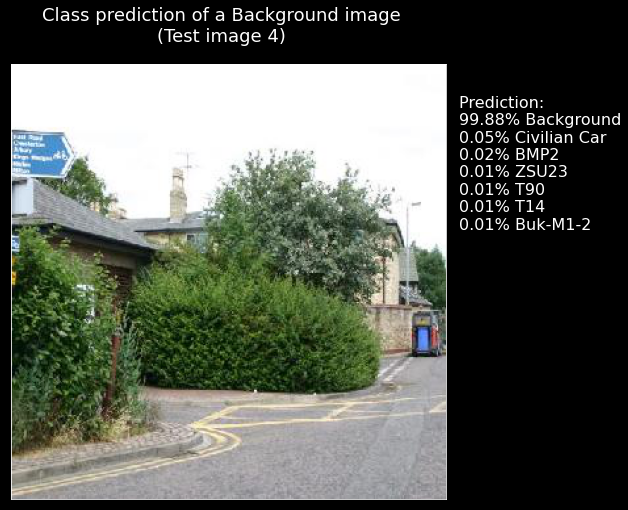


 Image 5 : [(99.75, 'Background'), (0.16, 'T90'), (0.03, 'T14'), (0.02, 'Civilian Car'), (0.02, 'Buk-M1-2'), (0.01, 'ZSU23'), (0.01, 'BMP2')]


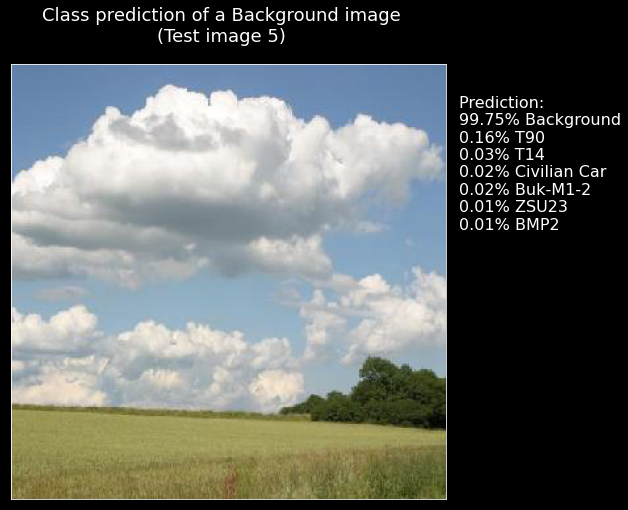


 Image 6 : [(99.83, 'Background'), (0.05, 'Civilian Car'), (0.04, 'BMP2'), (0.03, 'ZSU23'), (0.02, 'Buk-M1-2'), (0.01, 'T90'), (0.01, 'T14')]


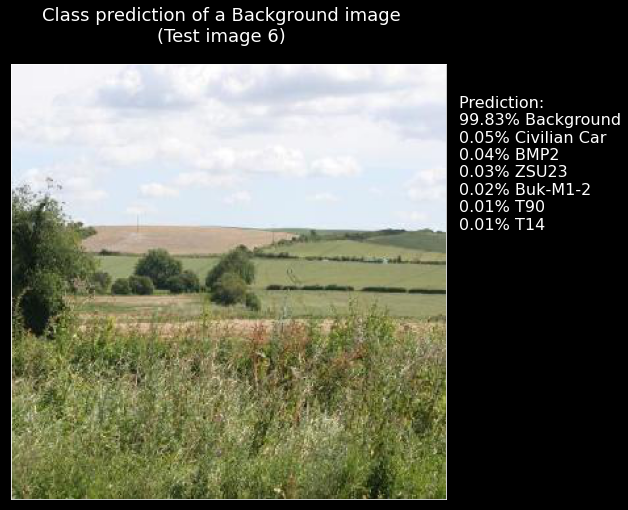


 Image 7 : [(99.68, 'Background'), (0.08, 'Civilian Car'), (0.08, 'BMP2'), (0.07, 'ZSU23'), (0.04, 'T90'), (0.03, 'T14'), (0.02, 'Buk-M1-2')]


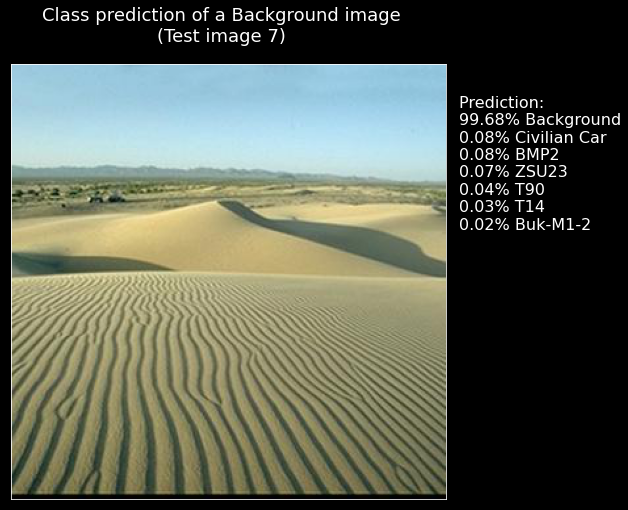


 Image 8 : [(97.1, 'Background'), (2.04, 'T14'), (0.29, 'Civilian Car'), (0.27, 'BMP2'), (0.15, 'Buk-M1-2'), (0.09, 'T90'), (0.06, 'ZSU23')]


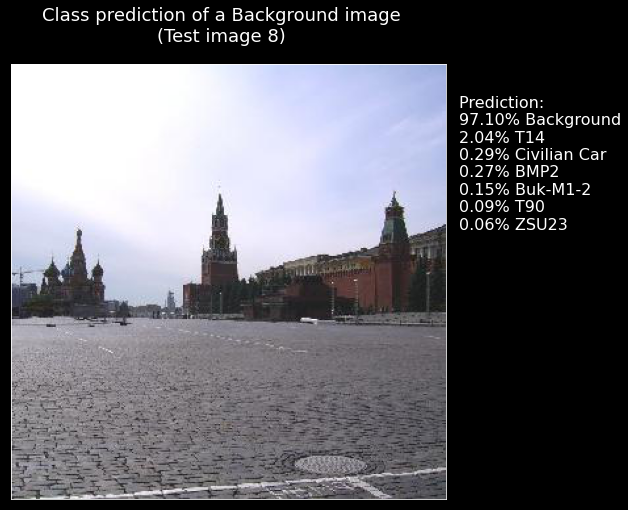


 Image 9 : [(99.27, 'Background'), (0.32, 'Civilian Car'), (0.15, 'BMP2'), (0.11, 'T90'), (0.06, 'T14'), (0.05, 'ZSU23'), (0.05, 'Buk-M1-2')]


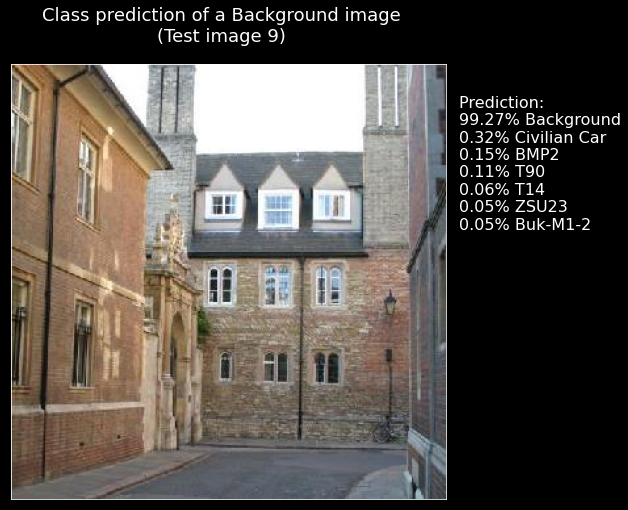


 Image 10 : [(99.83, 'Background'), (0.1, 'T90'), (0.02, 'T14'), (0.02, 'Civilian Car'), (0.01, 'ZSU23'), (0.01, 'Buk-M1-2'), (0.0, 'BMP2')]


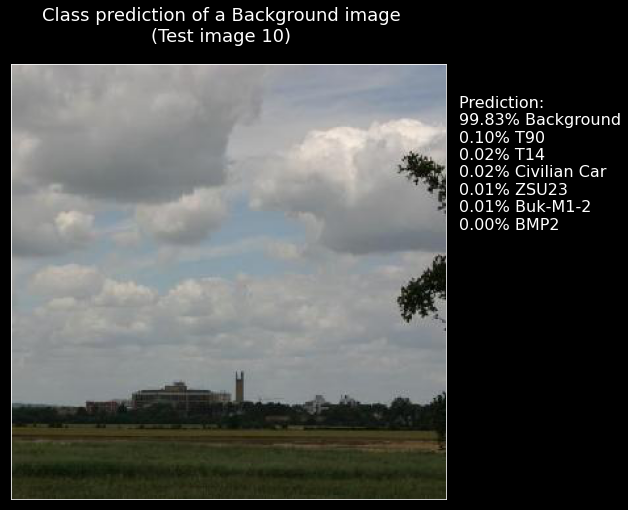


 Image 11 : [(99.82, 'Background'), (0.07, 'Civilian Car'), (0.04, 'T14'), (0.03, 'BMP2'), (0.02, 'T90'), (0.01, 'ZSU23'), (0.01, 'Buk-M1-2')]


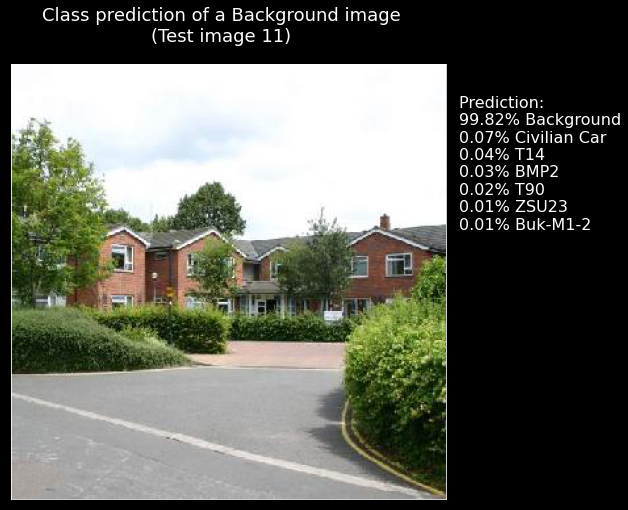


 Image 12 : [(99.82, 'Background'), (0.05, 'T14'), (0.05, 'Civilian Car'), (0.03, 'ZSU23'), (0.02, 'T90'), (0.02, 'BMP2'), (0.01, 'Buk-M1-2')]


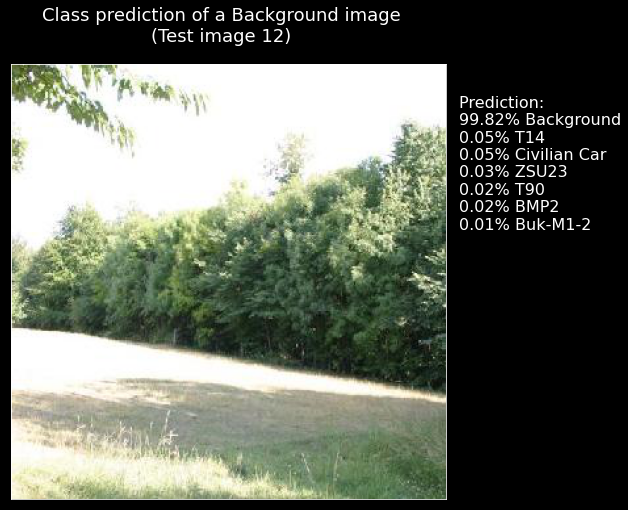


 Image 13 : [(98.17, 'Background'), (0.73, 'T14'), (0.4, 'Civilian Car'), (0.35, 'BMP2'), (0.19, 'T90'), (0.11, 'Buk-M1-2'), (0.05, 'ZSU23')]


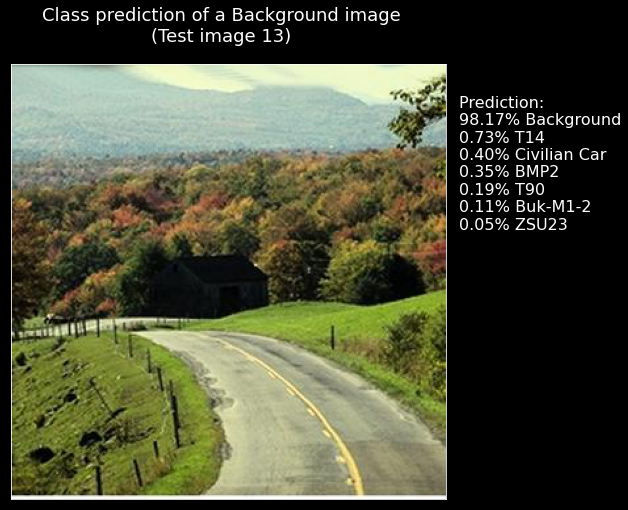


 Image 14 : [(99.74, 'Background'), (0.1, 'Civilian Car'), (0.06, 'T14'), (0.05, 'BMP2'), (0.02, 'T90'), (0.01, 'ZSU23'), (0.01, 'Buk-M1-2')]


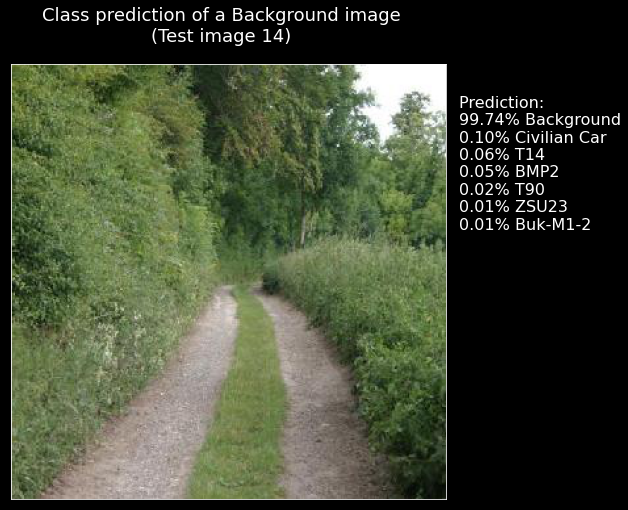


 Image 15 : [(99.82, 'Background'), (0.05, 'T90'), (0.04, 'T14'), (0.03, 'Civilian Car'), (0.02, 'ZSU23'), (0.02, 'Buk-M1-2'), (0.01, 'BMP2')]


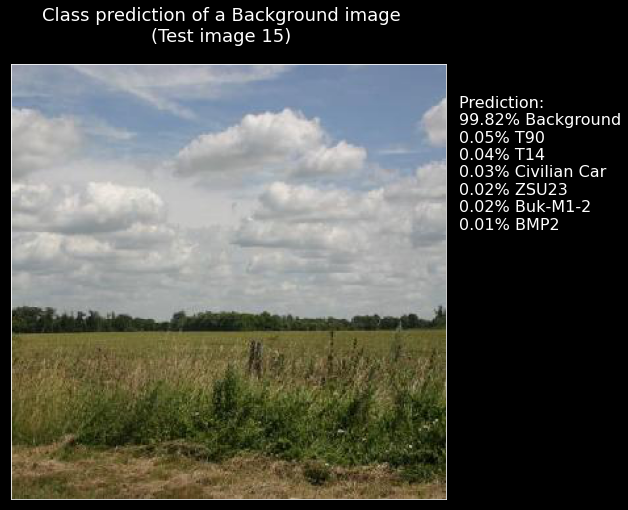


 Image 16 : [(82.2, 'BMP2'), (10.57, 'ZSU23'), (3.62, 'T14'), (1.56, 'Buk-M1-2'), (1.33, 'T90'), (0.46, 'Civilian Car'), (0.26, 'Background')]


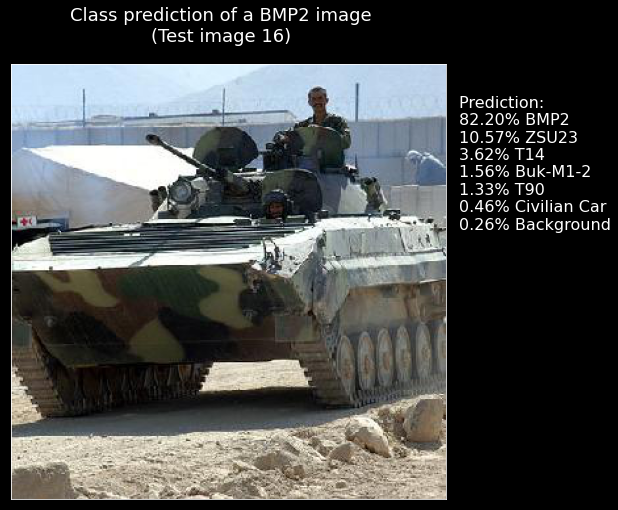


 Image 17 : [(66.22, 'BMP2'), (25.0, 'T90'), (6.21, 'T14'), (1.09, 'ZSU23'), (0.87, 'Buk-M1-2'), (0.4, 'Background'), (0.22, 'Civilian Car')]


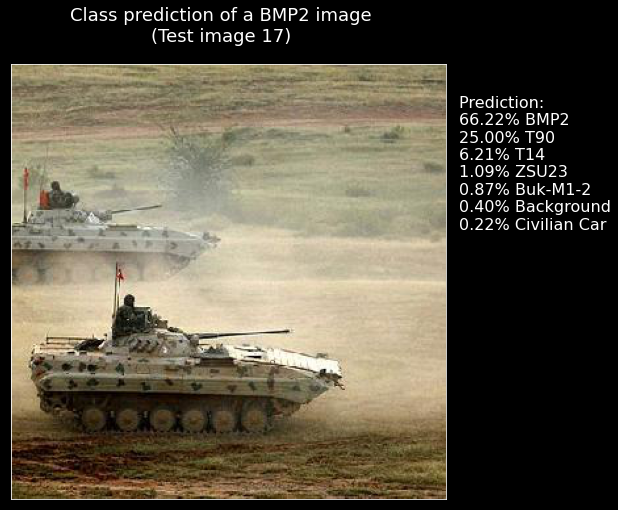


 Image 18 : [(98.43, 'BMP2'), (1.05, 'T14'), (0.3, 'T90'), (0.09, 'ZSU23'), (0.06, 'Buk-M1-2'), (0.04, 'Civilian Car'), (0.03, 'Background')]


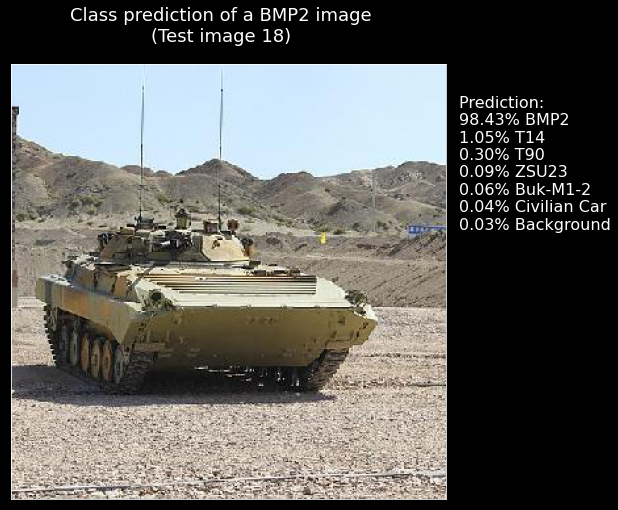


 Image 19 : [(84.15, 'BMP2'), (14.71, 'T14'), (0.44, 'T90'), (0.24, 'ZSU23'), (0.23, 'Civilian Car'), (0.13, 'Buk-M1-2'), (0.1, 'Background')]


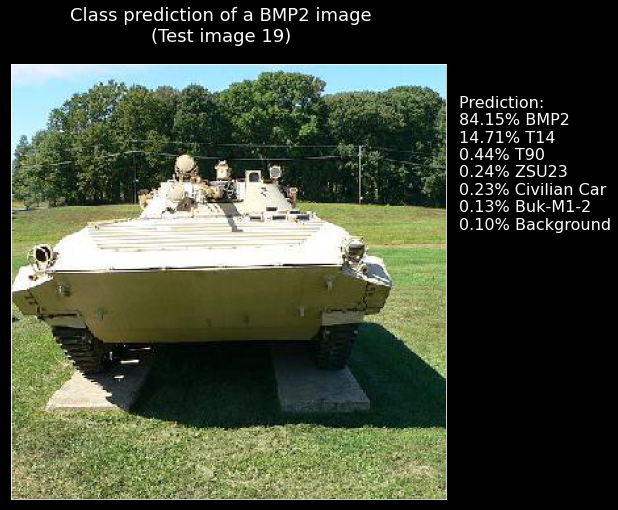


 Image 20 : [(86.73, 'T14'), (7.59, 'BMP2'), (4.66, 'T90'), (0.53, 'ZSU23'), (0.18, 'Civilian Car'), (0.18, 'Buk-M1-2'), (0.13, 'Background')]


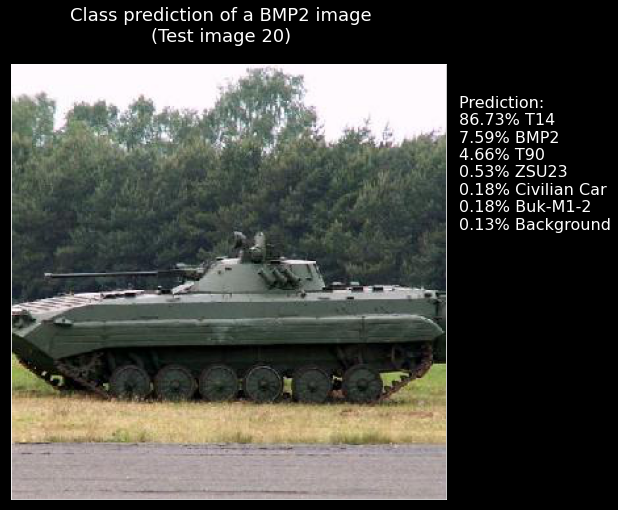


 Image 21 : [(98.44, 'BMP2'), (0.69, 'T90'), (0.34, 'ZSU23'), (0.3, 'Buk-M1-2'), (0.09, 'T14'), (0.09, 'Background'), (0.04, 'Civilian Car')]


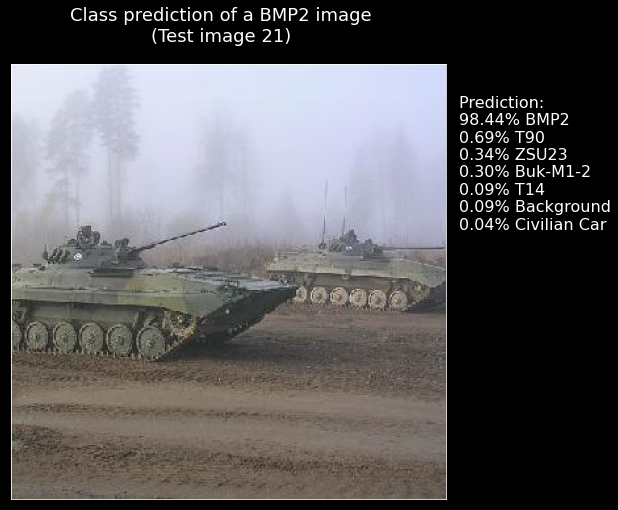


 Image 22 : [(46.1, 'ZSU23'), (42.19, 'BMP2'), (9.47, 'T90'), (0.66, 'T14'), (0.6, 'Buk-M1-2'), (0.52, 'Civilian Car'), (0.47, 'Background')]


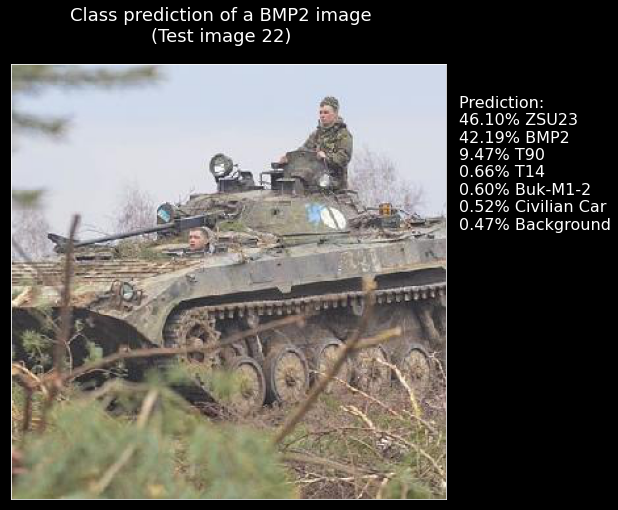


 Image 23 : [(86.04, 'BMP2'), (6.66, 'ZSU23'), (4.19, 'T90'), (2.16, 'T14'), (0.5, 'Buk-M1-2'), (0.34, 'Civilian Car'), (0.12, 'Background')]


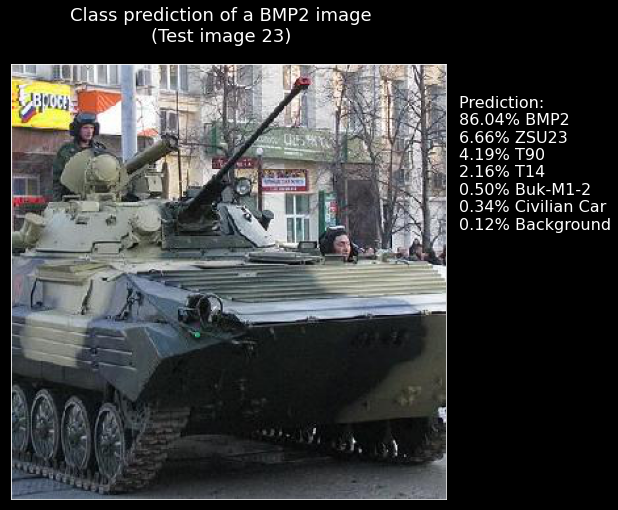


 Image 24 : [(84.33, 'BMP2'), (9.63, 'T90'), (2.93, 'T14'), (2.48, 'ZSU23'), (0.29, 'Civilian Car'), (0.21, 'Buk-M1-2'), (0.13, 'Background')]


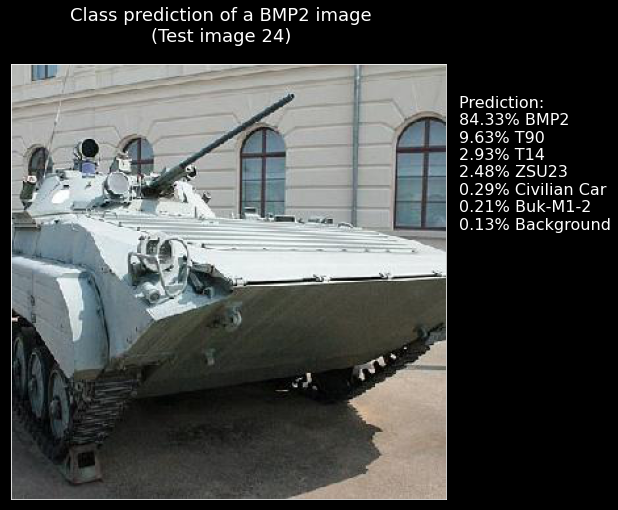


 Image 25 : [(92.77, 'BMP2'), (3.28, 'ZSU23'), (1.86, 'T14'), (1.58, 'T90'), (0.22, 'Civilian Car'), (0.15, 'Buk-M1-2'), (0.15, 'Background')]


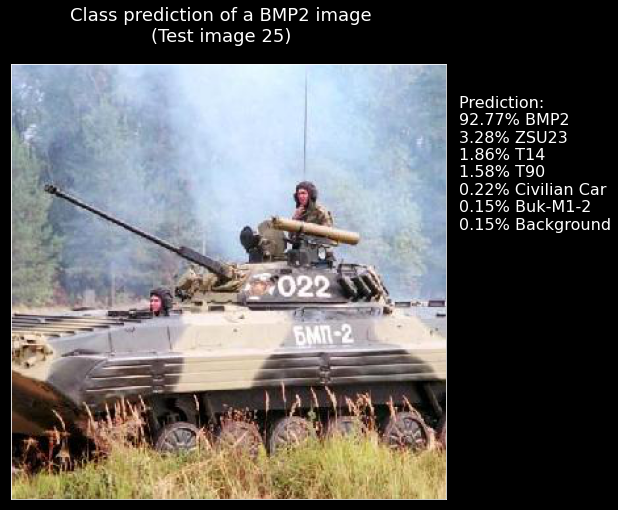


 Image 26 : [(90.18, 'BMP2'), (6.17, 'T14'), (1.96, 'ZSU23'), (0.7, 'T90'), (0.46, 'Buk-M1-2'), (0.31, 'Civilian Car'), (0.21, 'Background')]


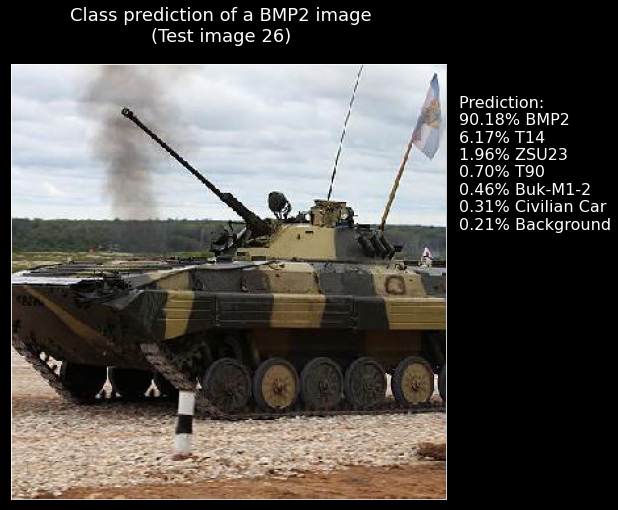


 Image 27 : [(86.08, 'BMP2'), (11.19, 'T90'), (0.98, 'ZSU23'), (0.91, 'T14'), (0.55, 'Buk-M1-2'), (0.21, 'Civilian Car'), (0.08, 'Background')]


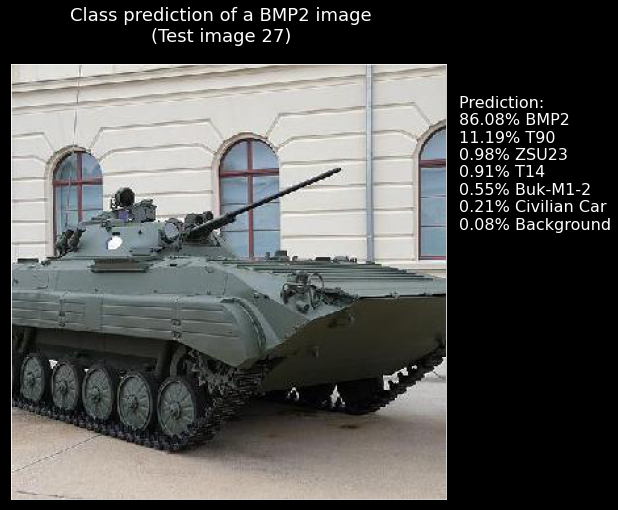


 Image 28 : [(95.67, 'BMP2'), (1.68, 'T14'), (1.1, 'T90'), (0.67, 'Buk-M1-2'), (0.62, 'ZSU23'), (0.17, 'Civilian Car'), (0.1, 'Background')]


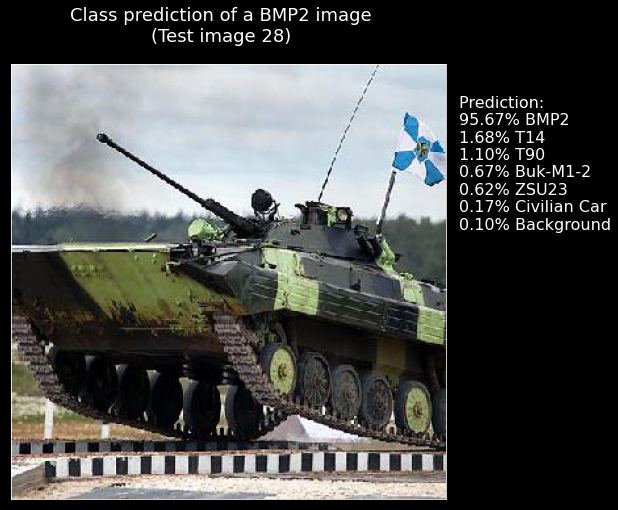


 Image 29 : [(89.38, 'BMP2'), (7.76, 'ZSU23'), (1.86, 'T90'), (0.49, 'T14'), (0.24, 'Buk-M1-2'), (0.17, 'Civilian Car'), (0.1, 'Background')]


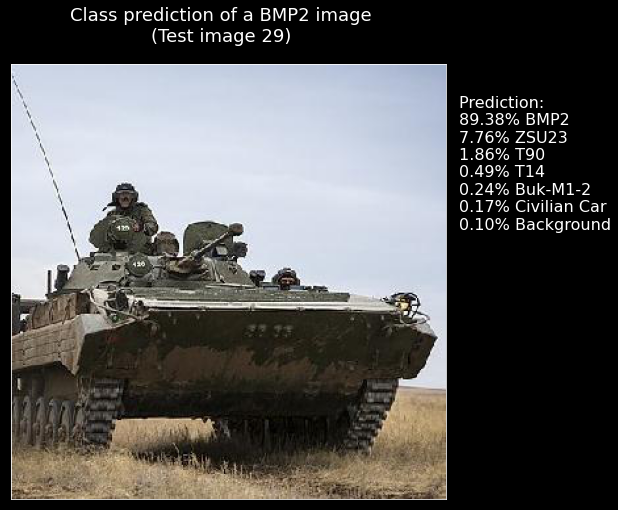


 Image 30 : [(86.9, 'BMP2'), (8.33, 'T14'), (1.88, 'ZSU23'), (1.45, 'T90'), (0.83, 'Civilian Car'), (0.3, 'Buk-M1-2'), (0.3, 'Background')]


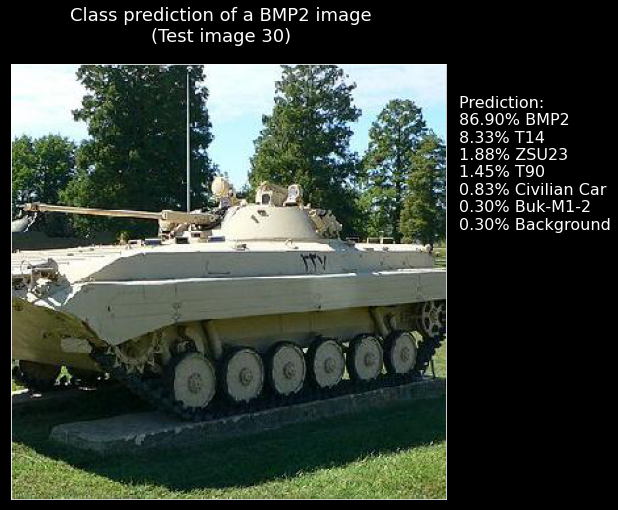


 Image 31 : [(98.96, 'Buk-M1-2'), (0.37, 'ZSU23'), (0.27, 'Civilian Car'), (0.18, 'T90'), (0.09, 'Background'), (0.07, 'BMP2'), (0.05, 'T14')]


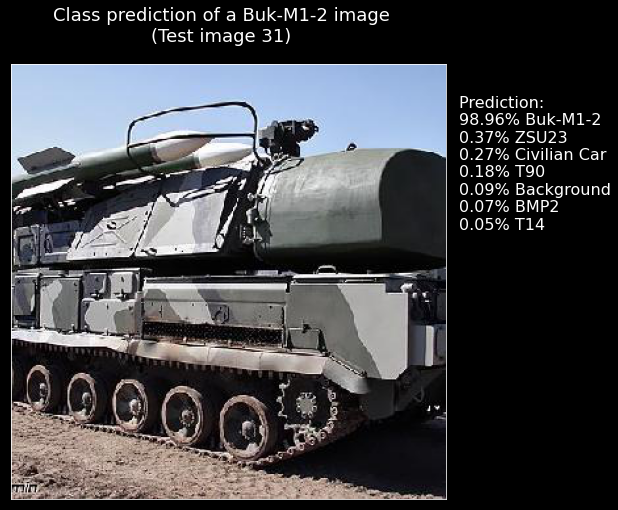


 Image 32 : [(93.21, 'Buk-M1-2'), (5.41, 'ZSU23'), (0.76, 'T90'), (0.35, 'Civilian Car'), (0.14, 'BMP2'), (0.07, 'T14'), (0.06, 'Background')]


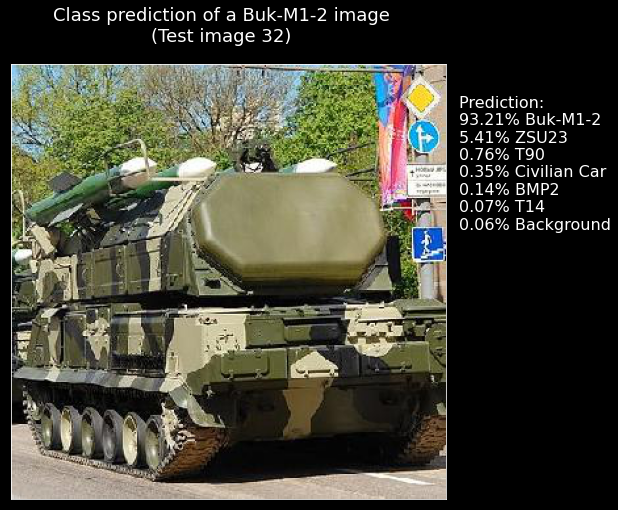


 Image 33 : [(93.08, 'Buk-M1-2'), (4.51, 'T90'), (1.35, 'BMP2'), (0.68, 'ZSU23'), (0.16, 'Civilian Car'), (0.15, 'T14'), (0.06, 'Background')]


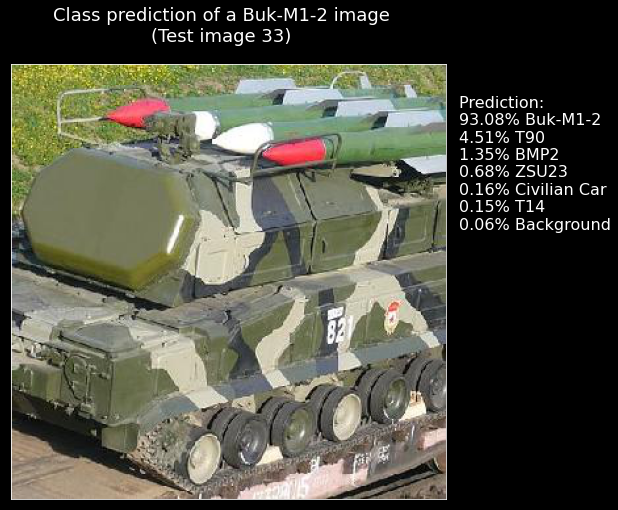


 Image 34 : [(90.87, 'Buk-M1-2'), (5.45, 'ZSU23'), (1.47, 'BMP2'), (1.25, 'T90'), (0.47, 'Civilian Car'), (0.36, 'Background'), (0.13, 'T14')]


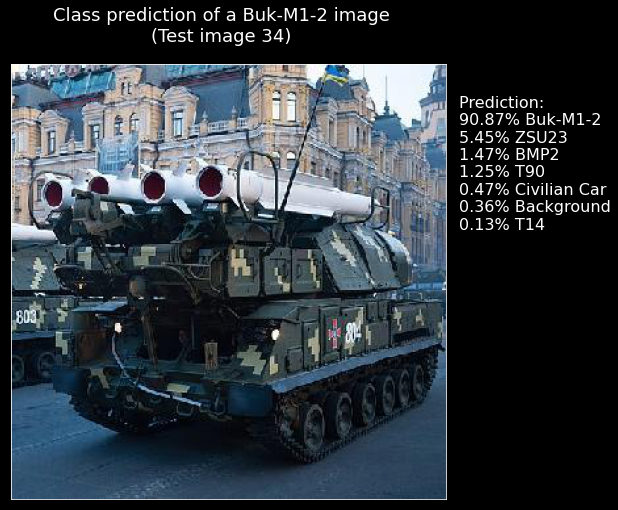


 Image 35 : [(90.14, 'Buk-M1-2'), (5.22, 'ZSU23'), (1.56, 'T90'), (1.42, 'Civilian Car'), (0.79, 'T14'), (0.59, 'Background'), (0.28, 'BMP2')]


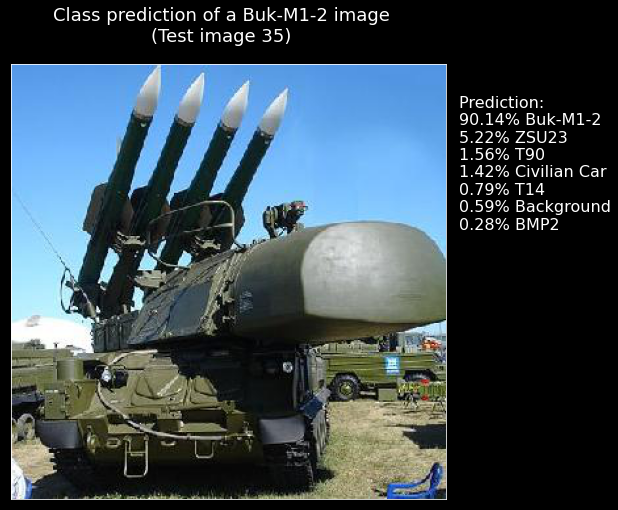


 Image 36 : [(93.5, 'Buk-M1-2'), (1.9, 'ZSU23'), (1.66, 'T14'), (1.58, 'T90'), (0.84, 'Civilian Car'), (0.31, 'Background'), (0.2, 'BMP2')]


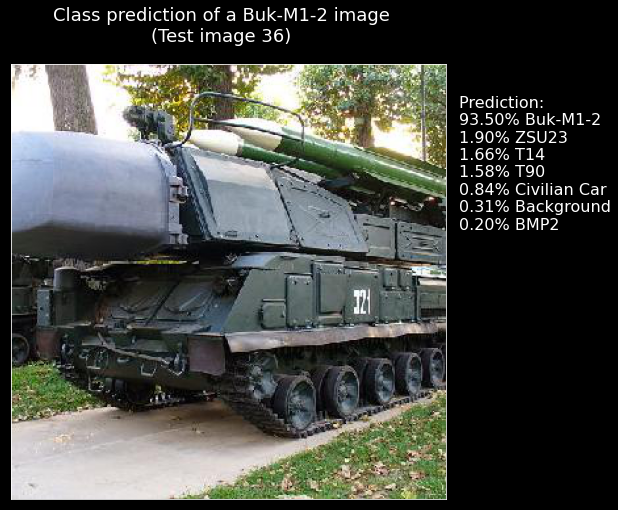


 Image 37 : [(97.7, 'Buk-M1-2'), (0.8, 'ZSU23'), (0.73, 'T90'), (0.47, 'Civilian Car'), (0.13, 'T14'), (0.11, 'Background'), (0.06, 'BMP2')]


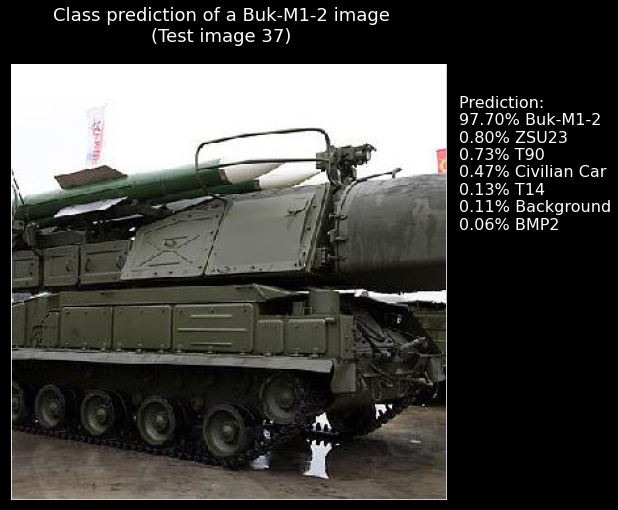


 Image 38 : [(83.71, 'Buk-M1-2'), (13.09, 'T90'), (2.28, 'ZSU23'), (0.42, 'BMP2'), (0.22, 'Civilian Car'), (0.2, 'T14'), (0.09, 'Background')]


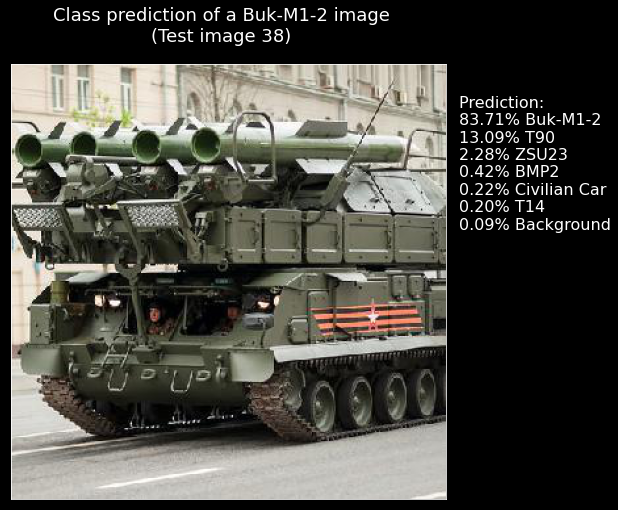


 Image 39 : [(99.69, 'Buk-M1-2'), (0.09, 'Civilian Car'), (0.08, 'T90'), (0.06, 'ZSU23'), (0.06, 'Background'), (0.01, 'T14'), (0.01, 'BMP2')]


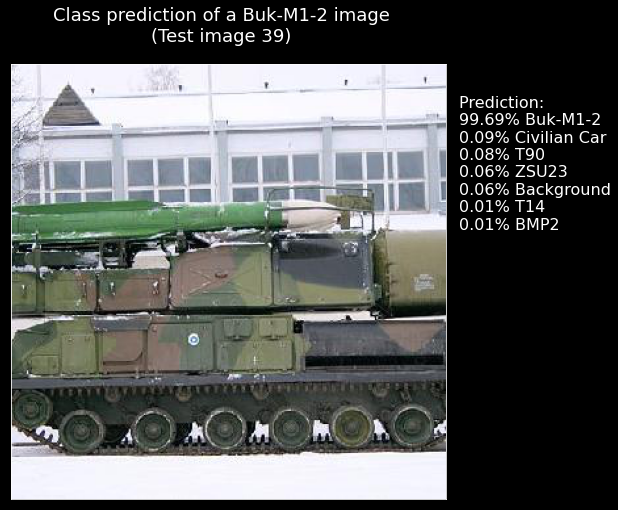


 Image 40 : [(96.55, 'Buk-M1-2'), (2.4, 'T90'), (0.38, 'ZSU23'), (0.26, 'Civilian Car'), (0.17, 'Background'), (0.13, 'BMP2'), (0.1, 'T14')]


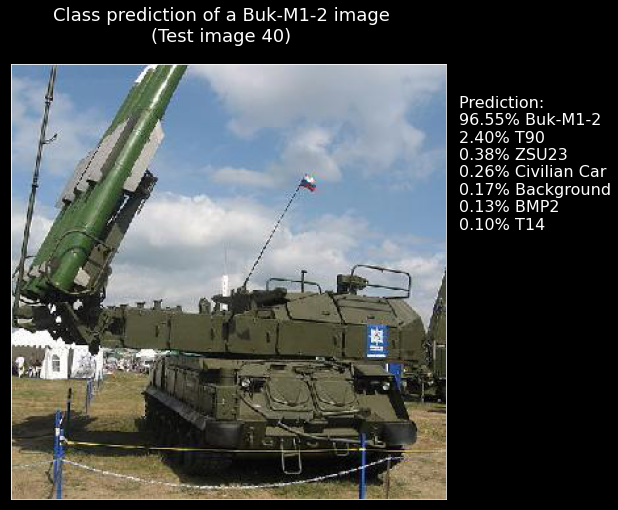


 Image 41 : [(98.46, 'Buk-M1-2'), (1.0, 'T90'), (0.14, 'ZSU23'), (0.11, 'T14'), (0.11, 'Background'), (0.1, 'Civilian Car'), (0.08, 'BMP2')]


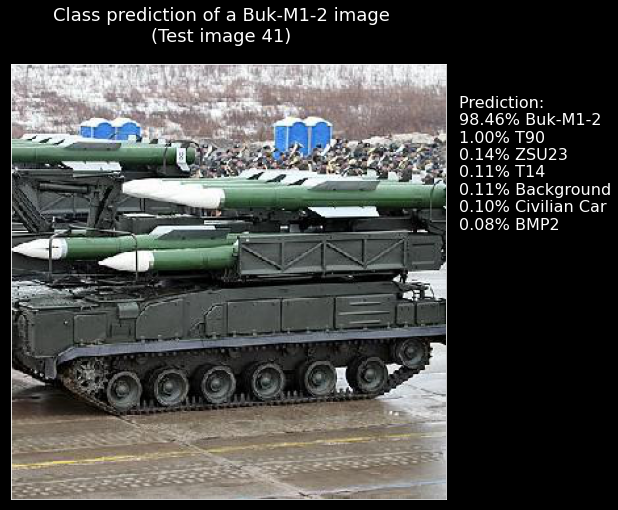


 Image 42 : [(98.39, 'Buk-M1-2'), (0.72, 'ZSU23'), (0.34, 'T90'), (0.25, 'Civilian Car'), (0.13, 'T14'), (0.1, 'Background'), (0.07, 'BMP2')]


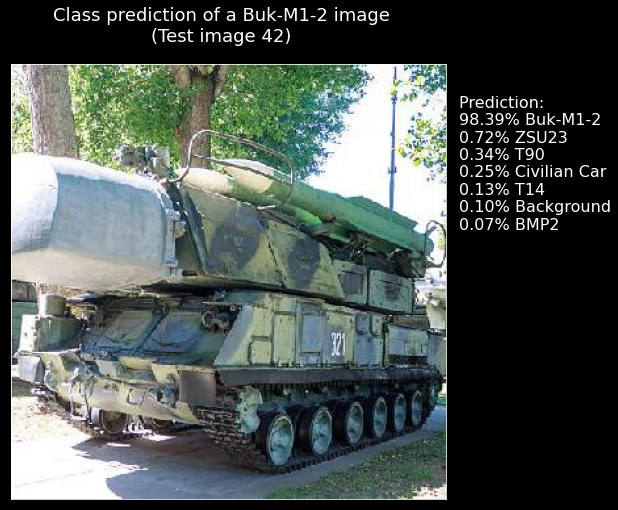


 Image 43 : [(75.79, 'Buk-M1-2'), (17.73, 'T90'), (5.06, 'ZSU23'), (0.62, 'BMP2'), (0.35, 'Civilian Car'), (0.27, 'T14'), (0.18, 'Background')]


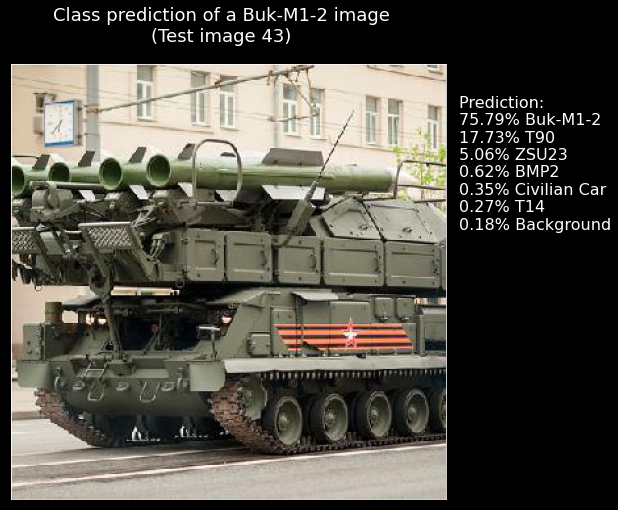


 Image 44 : [(99.3, 'Buk-M1-2'), (0.34, 'T90'), (0.12, 'ZSU23'), (0.09, 'T14'), (0.09, 'Civilian Car'), (0.04, 'Background'), (0.02, 'BMP2')]


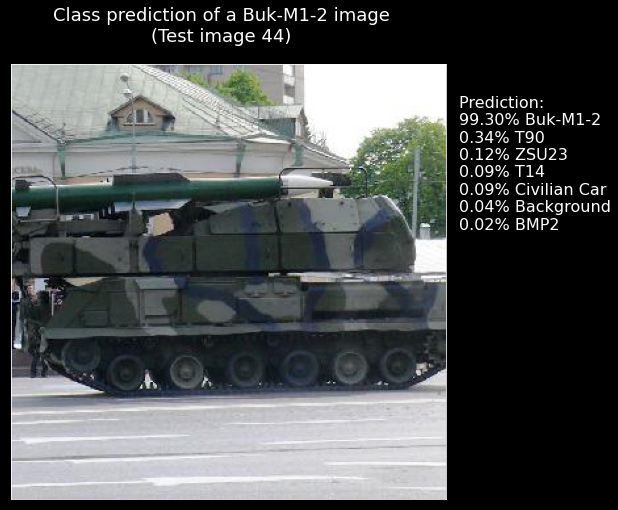


 Image 45 : [(97.35, 'Buk-M1-2'), (1.33, 'T90'), (0.43, 'ZSU23'), (0.32, 'Background'), (0.3, 'Civilian Car'), (0.16, 'BMP2'), (0.12, 'T14')]


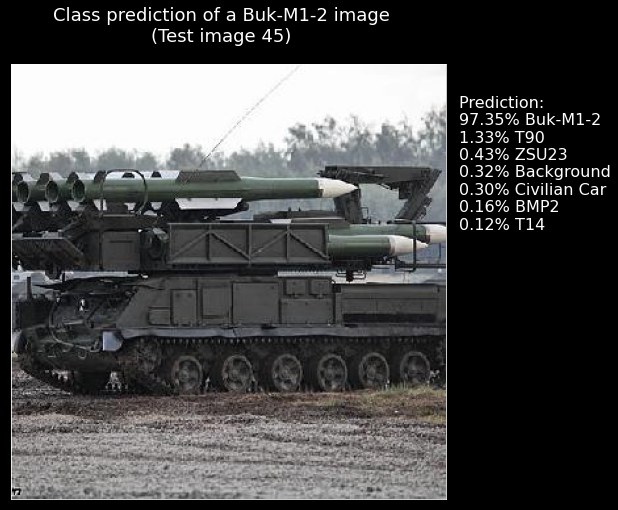


 Image 46 : [(99.8, 'Civilian Car'), (0.1, 'Background'), (0.04, 'T14'), (0.03, 'ZSU23'), (0.02, 'BMP2'), (0.01, 'T90'), (0.01, 'Buk-M1-2')]


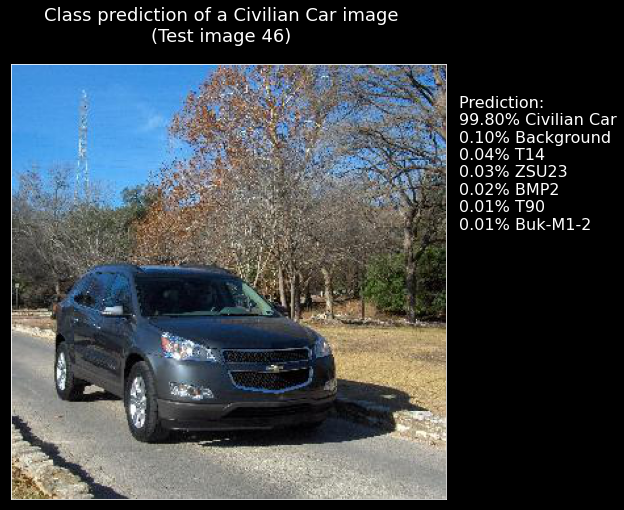


 Image 47 : [(99.74, 'Civilian Car'), (0.11, 'Background'), (0.07, 'ZSU23'), (0.04, 'T14'), (0.02, 'Buk-M1-2'), (0.01, 'T90'), (0.01, 'BMP2')]


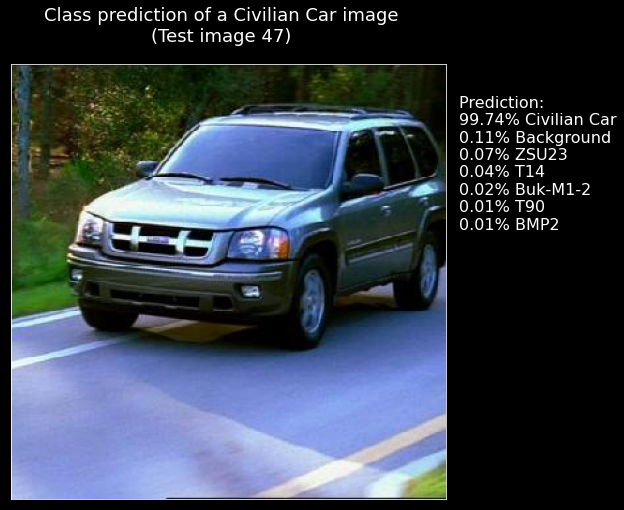


 Image 48 : [(99.57, 'Civilian Car'), (0.18, 'Background'), (0.09, 'ZSU23'), (0.07, 'BMP2'), (0.05, 'T14'), (0.03, 'Buk-M1-2'), (0.01, 'T90')]


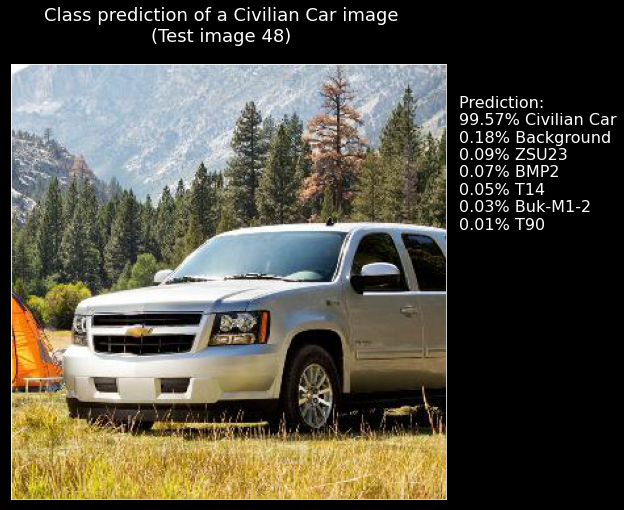


 Image 49 : [(99.93, 'Civilian Car'), (0.02, 'ZSU23'), (0.01, 'T14'), (0.01, 'Buk-M1-2'), (0.01, 'Background'), (0.01, 'BMP2'), (0.0, 'T90')]


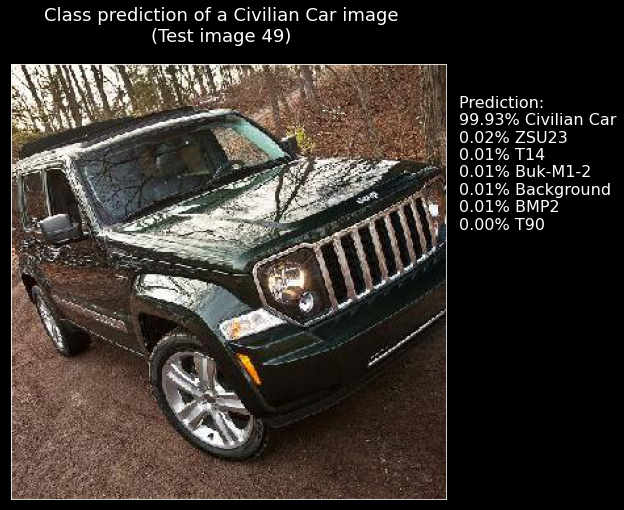


 Image 50 : [(99.74, 'Civilian Car'), (0.13, 'Background'), (0.05, 'ZSU23'), (0.04, 'T14'), (0.03, 'BMP2'), (0.01, 'T90'), (0.01, 'Buk-M1-2')]


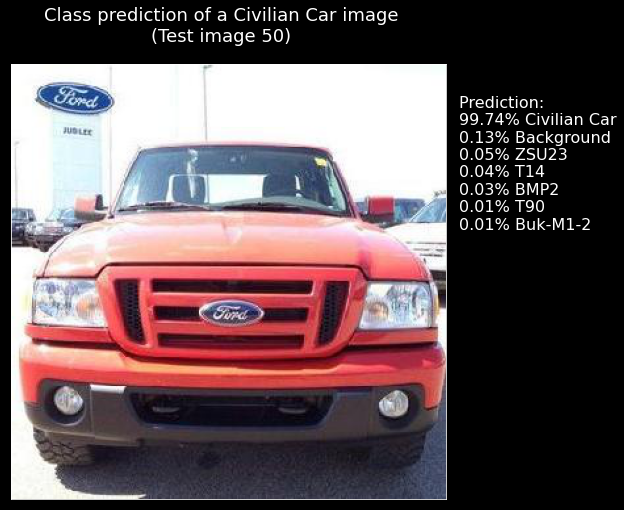


 Image 51 : [(99.86, 'Civilian Car'), (0.05, 'Background'), (0.03, 'ZSU23'), (0.02, 'T14'), (0.02, 'BMP2'), (0.01, 'T90'), (0.01, 'Buk-M1-2')]


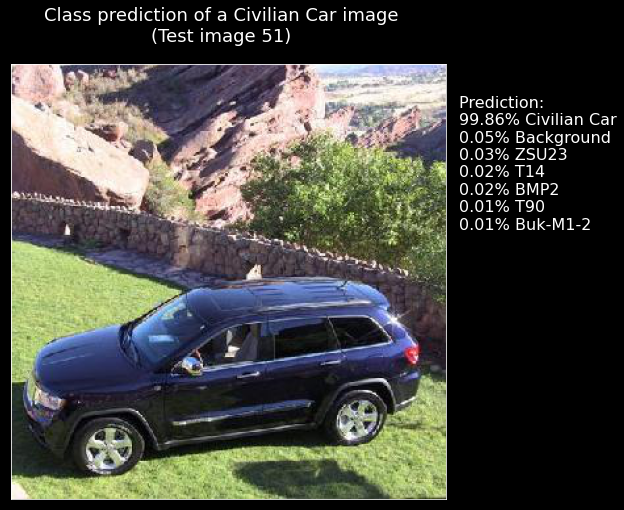


 Image 52 : [(99.9, 'Civilian Car'), (0.04, 'Background'), (0.02, 'T14'), (0.02, 'BMP2'), (0.01, 'ZSU23'), (0.01, 'T90'), (0.01, 'Buk-M1-2')]


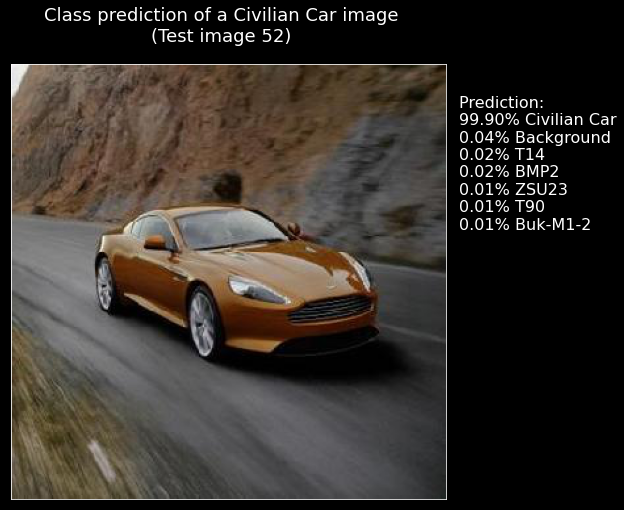


 Image 53 : [(99.85, 'Civilian Car'), (0.05, 'Background'), (0.03, 'T14'), (0.02, 'ZSU23'), (0.02, 'BMP2'), (0.01, 'T90'), (0.01, 'Buk-M1-2')]


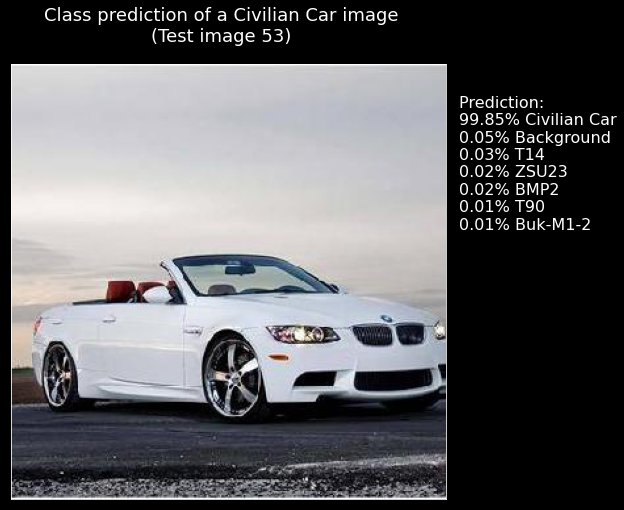


 Image 54 : [(99.65, 'Civilian Car'), (0.14, 'Background'), (0.07, 'ZSU23'), (0.07, 'T14'), (0.03, 'Buk-M1-2'), (0.02, 'T90'), (0.02, 'BMP2')]


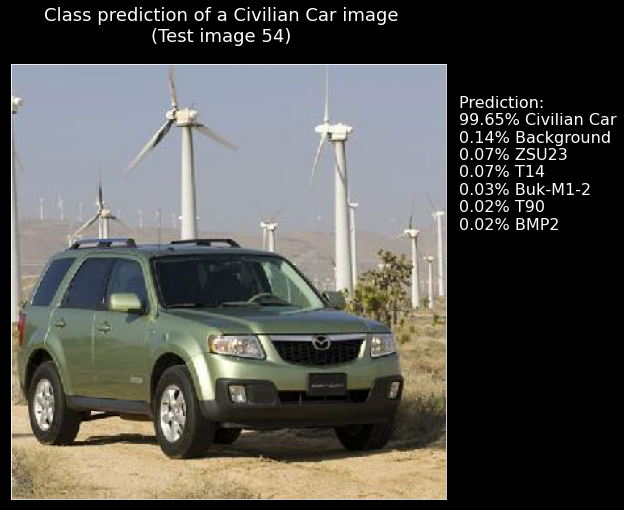


 Image 55 : [(99.82, 'Civilian Car'), (0.05, 'T14'), (0.04, 'ZSU23'), (0.04, 'Background'), (0.02, 'T90'), (0.02, 'BMP2'), (0.01, 'Buk-M1-2')]


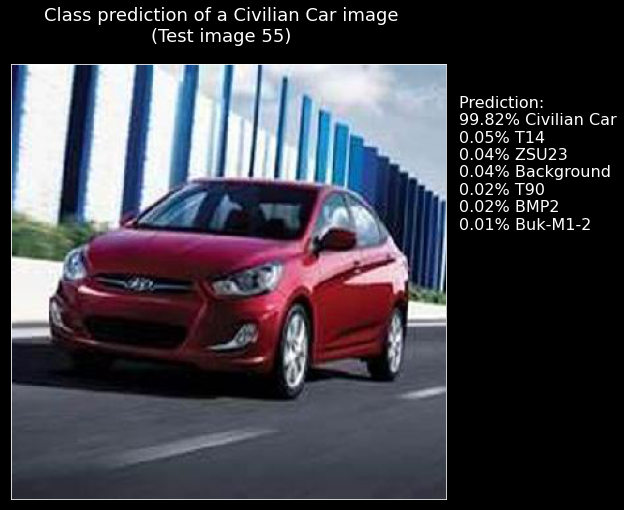


 Image 56 : [(99.71, 'Civilian Car'), (0.11, 'Background'), (0.06, 'ZSU23'), (0.06, 'T14'), (0.03, 'T90'), (0.03, 'BMP2'), (0.01, 'Buk-M1-2')]


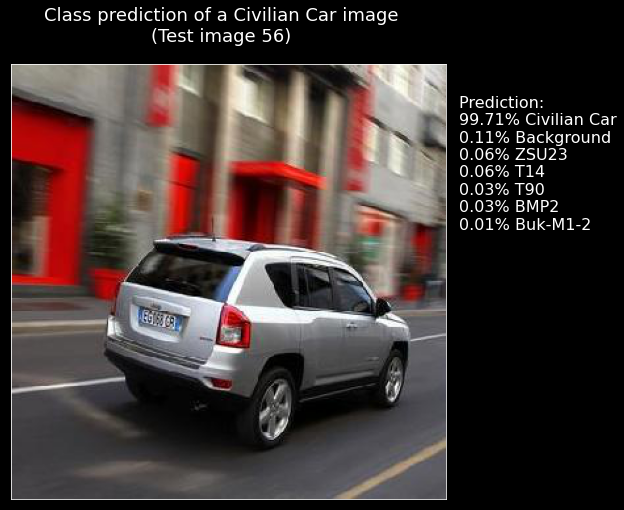


 Image 57 : [(99.87, 'Civilian Car'), (0.04, 'Background'), (0.03, 'ZSU23'), (0.03, 'T14'), (0.01, 'T90'), (0.01, 'Buk-M1-2'), (0.01, 'BMP2')]


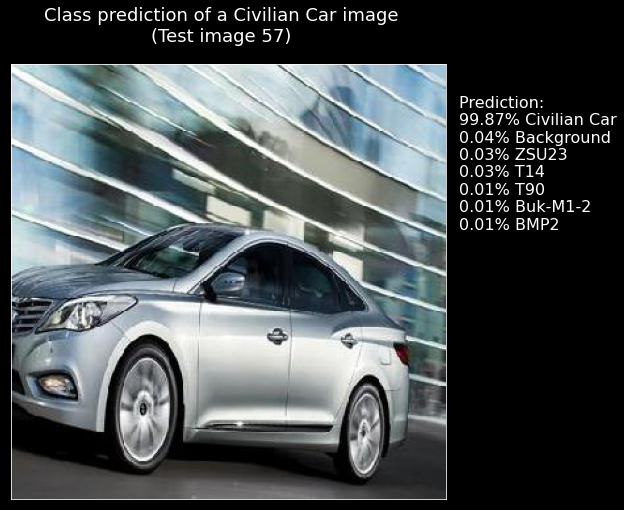


 Image 58 : [(99.8, 'Civilian Car'), (0.08, 'ZSU23'), (0.05, 'Background'), (0.04, 'T14'), (0.02, 'T90'), (0.01, 'BMP2'), (0.0, 'Buk-M1-2')]


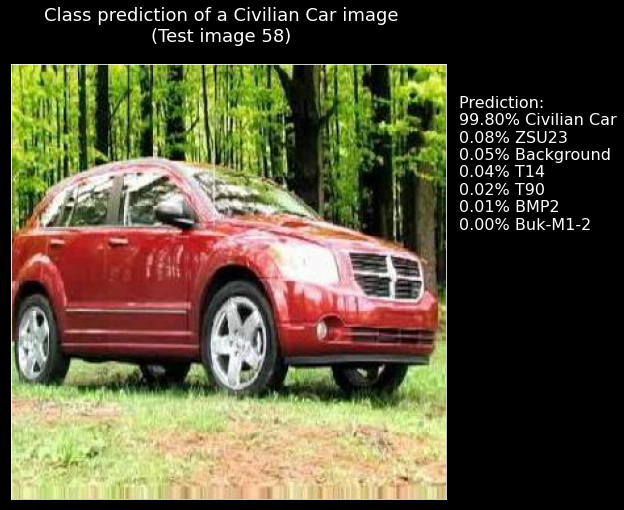


 Image 59 : [(99.89, 'Civilian Car'), (0.03, 'Background'), (0.02, 'ZSU23'), (0.02, 'T14'), (0.01, 'T90'), (0.01, 'Buk-M1-2'), (0.01, 'BMP2')]


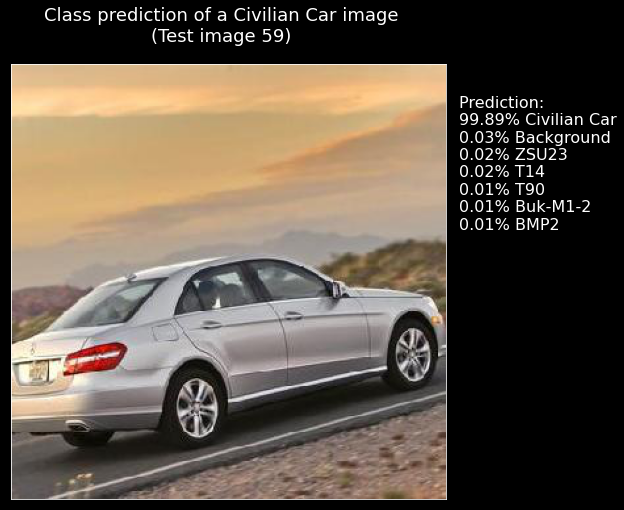


 Image 60 : [(99.87, 'Civilian Car'), (0.07, 'Background'), (0.02, 'T14'), (0.01, 'ZSU23'), (0.01, 'T90'), (0.01, 'Buk-M1-2'), (0.01, 'BMP2')]


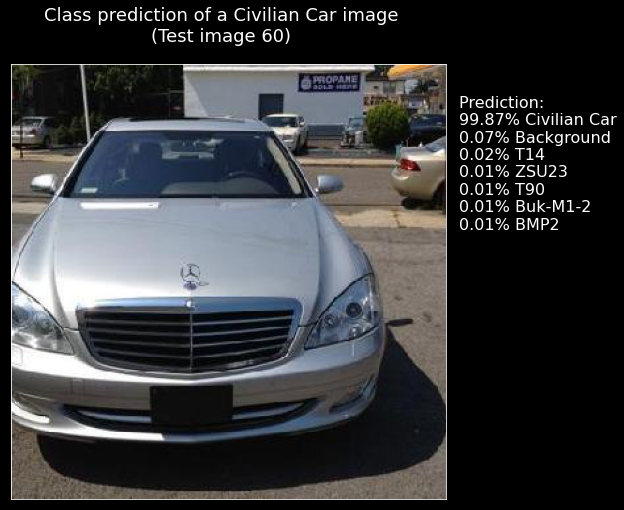


 Image 61 : [(97.21, 'T14'), (2.11, 'T90'), (0.43, 'BMP2'), (0.11, 'ZSU23'), (0.07, 'Buk-M1-2'), (0.05, 'Civilian Car'), (0.03, 'Background')]


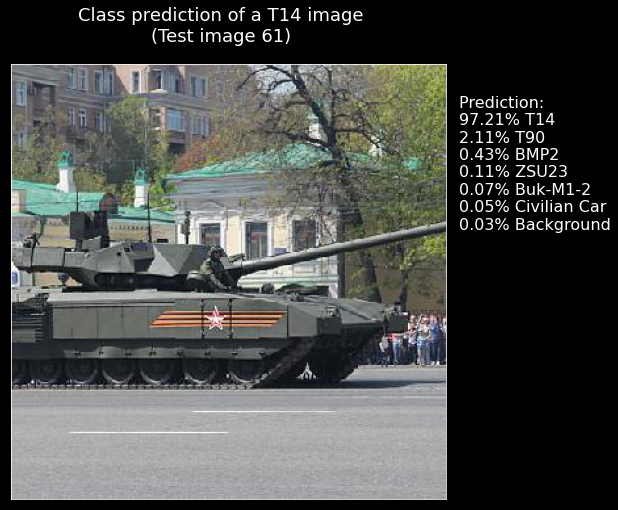


 Image 62 : [(66.95, 'T90'), (22.32, 'T14'), (5.34, 'BMP2'), (2.66, 'Buk-M1-2'), (2.04, 'ZSU23'), (0.57, 'Civilian Car'), (0.13, 'Background')]


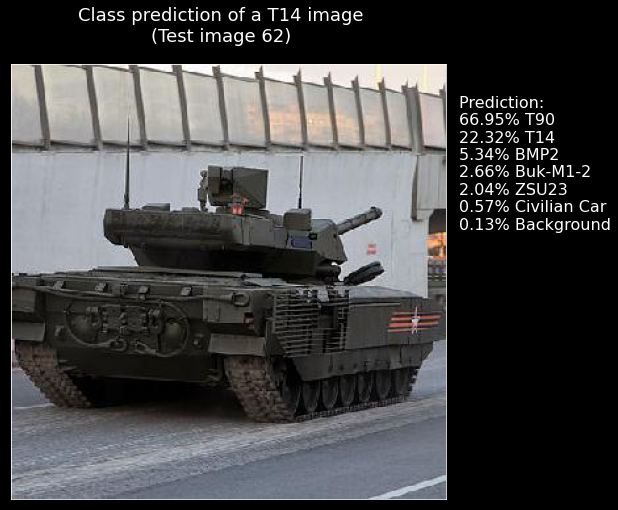


 Image 63 : [(86.69, 'T14'), (6.44, 'T90'), (5.95, 'BMP2'), (0.52, 'Buk-M1-2'), (0.19, 'ZSU23'), (0.16, 'Civilian Car'), (0.05, 'Background')]


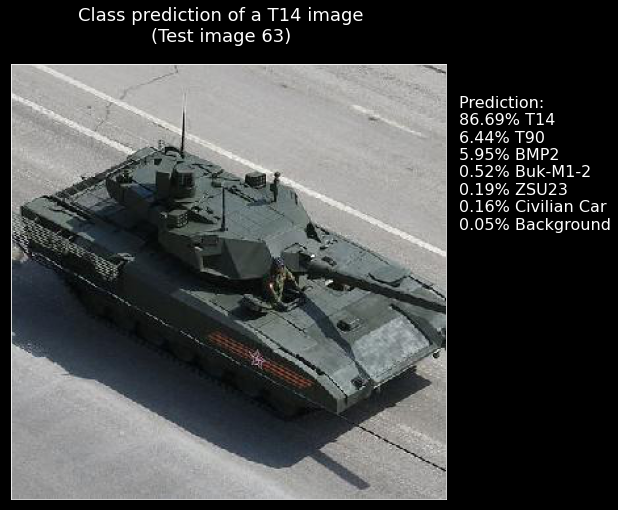


 Image 64 : [(68.17, 'T90'), (25.15, 'T14'), (3.06, 'Buk-M1-2'), (2.83, 'BMP2'), (0.3, 'ZSU23'), (0.28, 'Civilian Car'), (0.22, 'Background')]


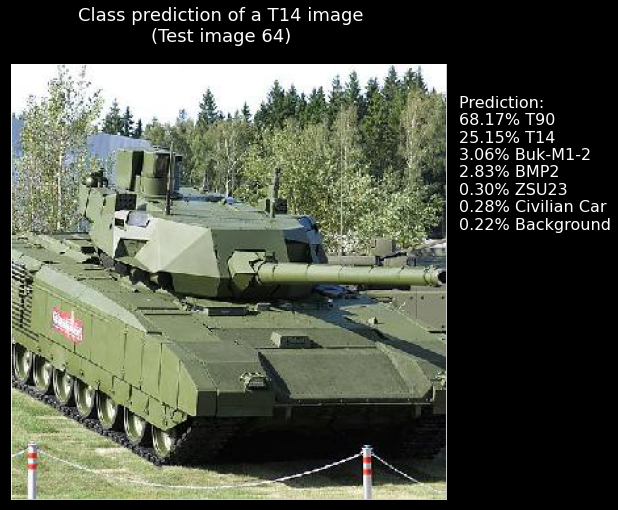


 Image 65 : [(55.26, 'T90'), (32.57, 'T14'), (8.21, 'BMP2'), (1.97, 'ZSU23'), (1.35, 'Buk-M1-2'), (0.4, 'Civilian Car'), (0.24, 'Background')]


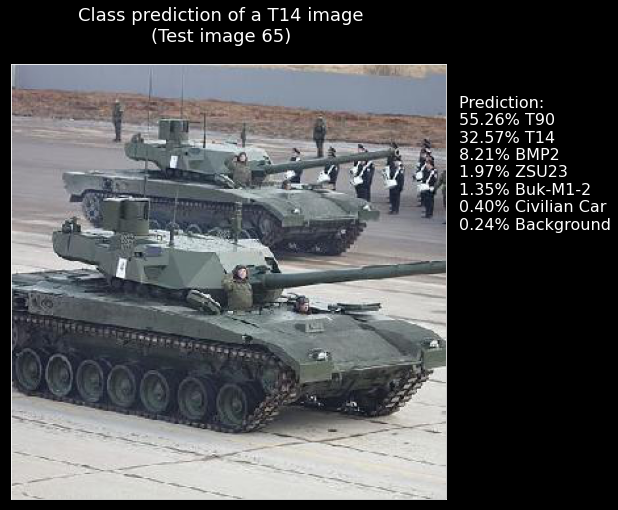


 Image 66 : [(66.41, 'T14'), (13.85, 'BMP2'), (6.49, 'T90'), (5.86, 'Buk-M1-2'), (3.65, 'ZSU23'), (2.18, 'Civilian Car'), (1.57, 'Background')]


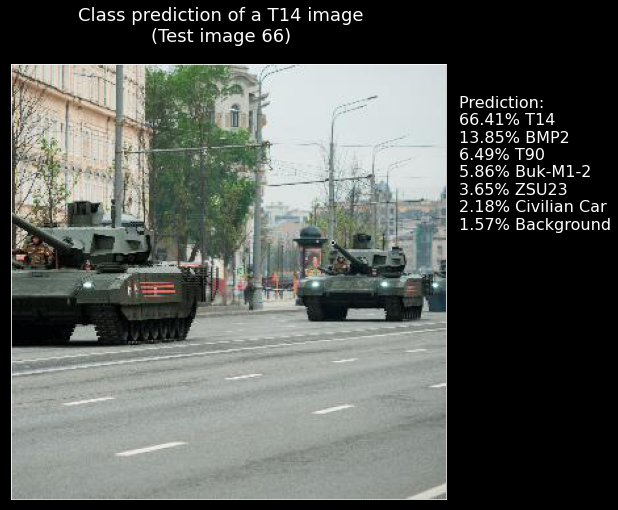


 Image 67 : [(92.7, 'T14'), (5.22, 'T90'), (0.84, 'BMP2'), (0.75, 'ZSU23'), (0.24, 'Buk-M1-2'), (0.19, 'Civilian Car'), (0.06, 'Background')]


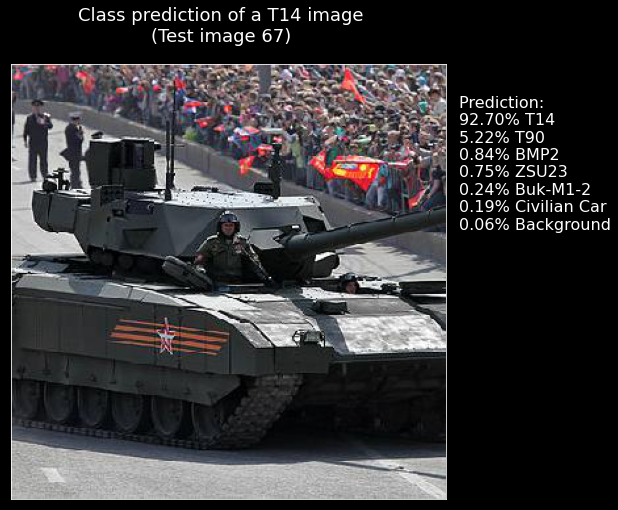


 Image 68 : [(86.11, 'T14'), (10.56, 'T90'), (1.92, 'BMP2'), (0.65, 'Buk-M1-2'), (0.32, 'Civilian Car'), (0.28, 'ZSU23'), (0.16, 'Background')]


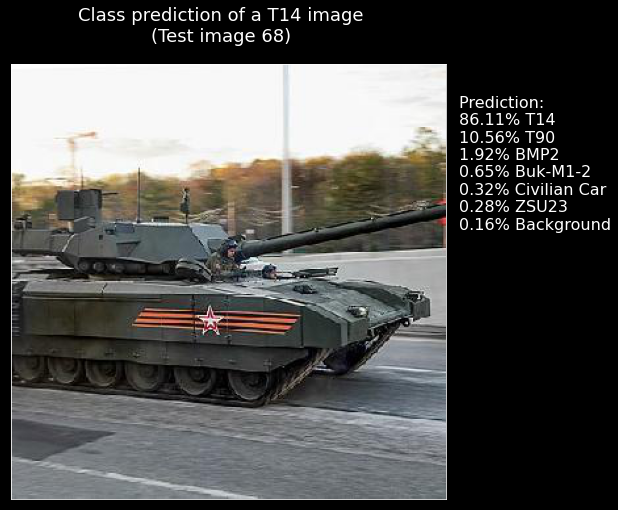


 Image 69 : [(89.41, 'T14'), (5.61, 'T90'), (2.3, 'ZSU23'), (1.69, 'Civilian Car'), (0.67, 'BMP2'), (0.29, 'Buk-M1-2'), (0.03, 'Background')]


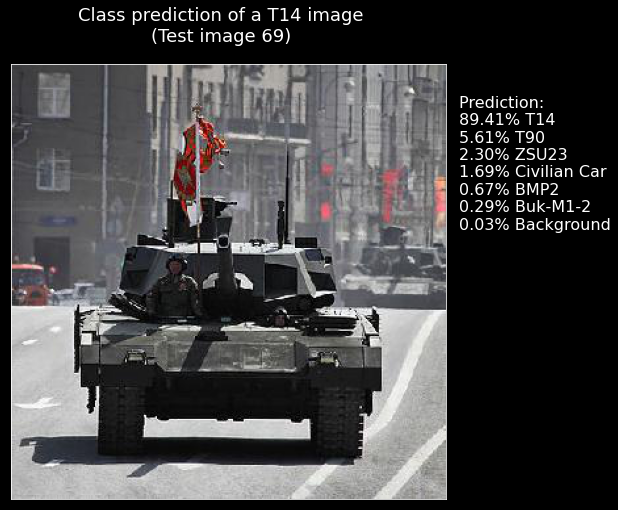


 Image 70 : [(96.99, 'T14'), (1.72, 'BMP2'), (1.03, 'T90'), (0.08, 'Buk-M1-2'), (0.07, 'Civilian Car'), (0.06, 'ZSU23'), (0.06, 'Background')]


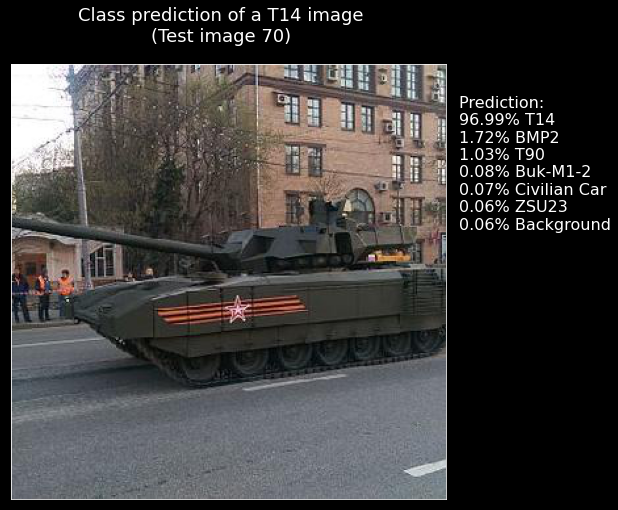


 Image 71 : [(63.24, 'T90'), (19.47, 'T14'), (8.14, 'ZSU23'), (6.25, 'BMP2'), (2.17, 'Buk-M1-2'), (0.59, 'Civilian Car'), (0.14, 'Background')]


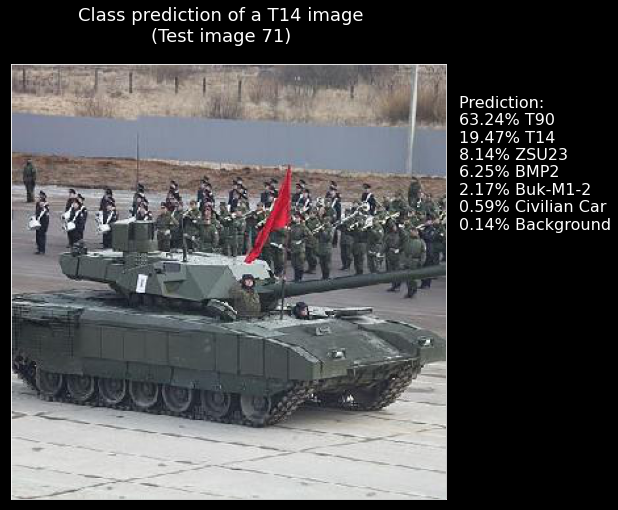


 Image 72 : [(92.82, 'T90'), (3.37, 'T14'), (1.96, 'ZSU23'), (0.92, 'Buk-M1-2'), (0.67, 'BMP2'), (0.2, 'Civilian Car'), (0.08, 'Background')]


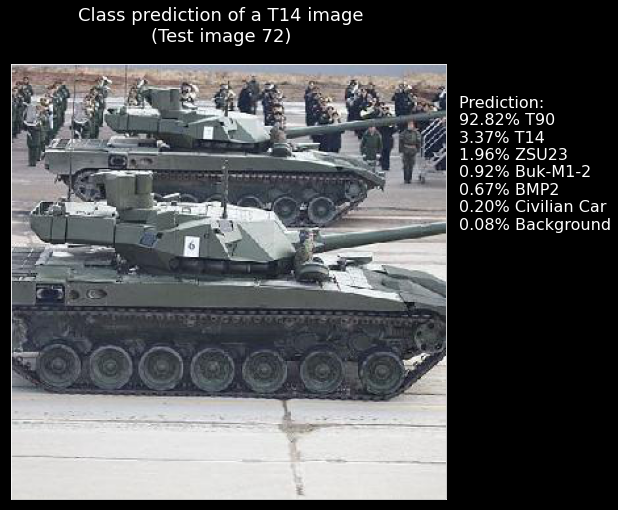


 Image 73 : [(70.78, 'T14'), (24.1, 'T90'), (2.29, 'ZSU23'), (1.24, 'Buk-M1-2'), (0.99, 'BMP2'), (0.43, 'Civilian Car'), (0.19, 'Background')]


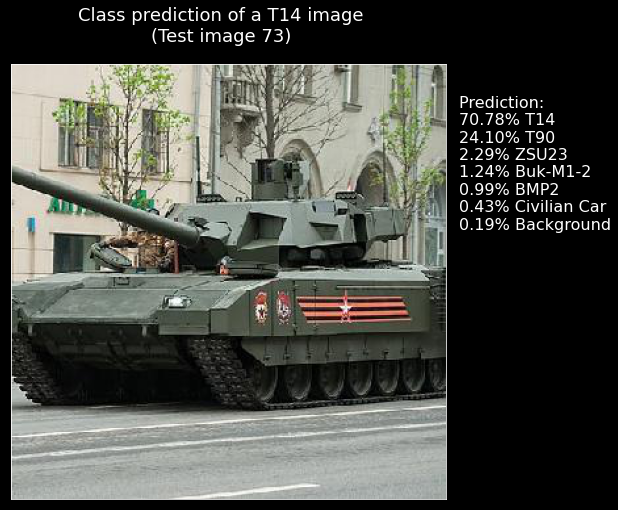


 Image 74 : [(92.91, 'T90'), (3.8, 'T14'), (2.45, 'Buk-M1-2'), (0.52, 'BMP2'), (0.15, 'ZSU23'), (0.1, 'Civilian Car'), (0.07, 'Background')]


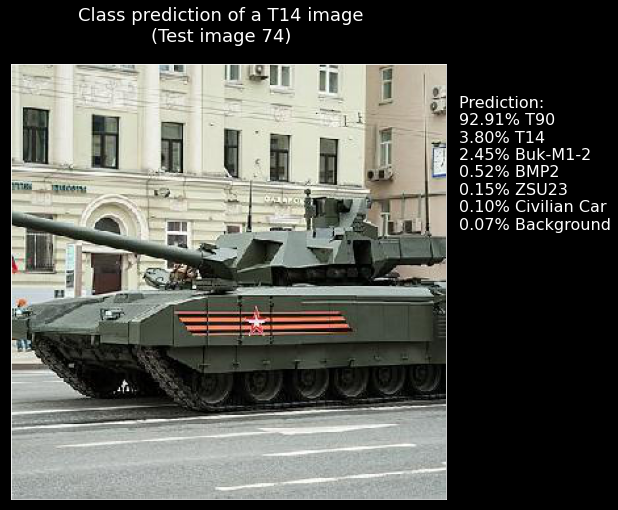


 Image 75 : [(86.24, 'T14'), (6.11, 'BMP2'), (2.59, 'ZSU23'), (2.13, 'T90'), (2.01, 'Buk-M1-2'), (0.82, 'Civilian Car'), (0.1, 'Background')]


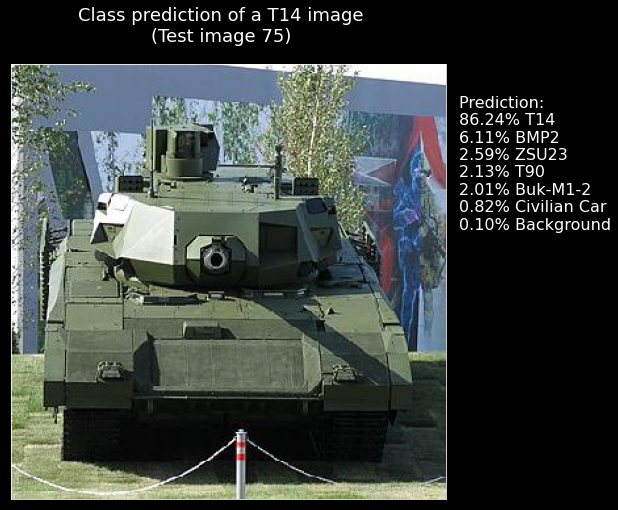


 Image 76 : [(82.53, 'T90'), (13.46, 'T14'), (2.34, 'ZSU23'), (1.31, 'BMP2'), (0.17, 'Background'), (0.11, 'Buk-M1-2'), (0.08, 'Civilian Car')]


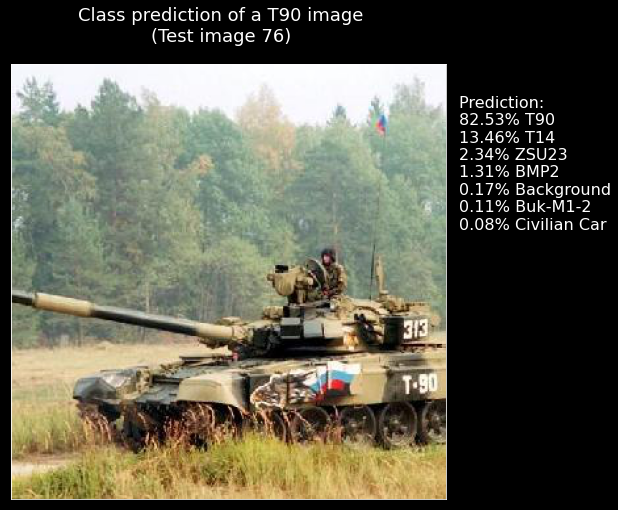


 Image 77 : [(92.62, 'T90'), (4.22, 'T14'), (1.12, 'ZSU23'), (1.07, 'Buk-M1-2'), (0.69, 'BMP2'), (0.18, 'Civilian Car'), (0.11, 'Background')]


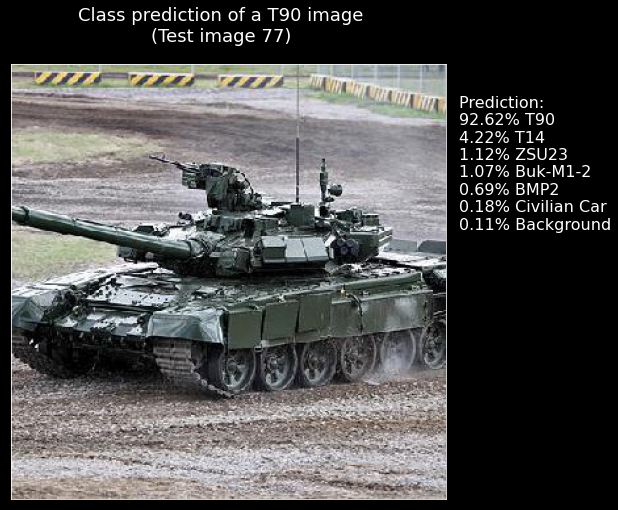


 Image 78 : [(89.8, 'T90'), (4.76, 'T14'), (2.37, 'BMP2'), (2.13, 'ZSU23'), (0.58, 'Buk-M1-2'), (0.22, 'Civilian Car'), (0.13, 'Background')]


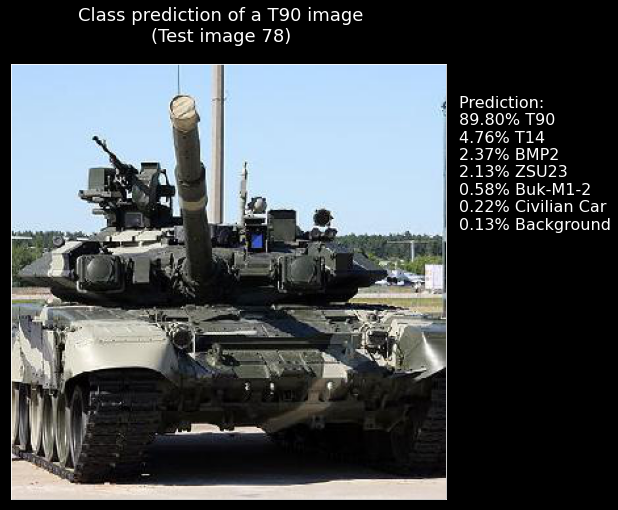


 Image 79 : [(94.06, 'T90'), (3.89, 'T14'), (1.0, 'BMP2'), (0.79, 'ZSU23'), (0.12, 'Buk-M1-2'), (0.07, 'Civilian Car'), (0.06, 'Background')]


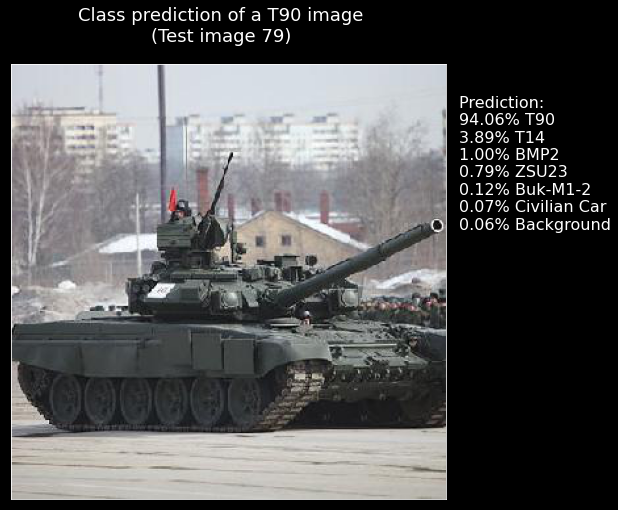


 Image 80 : [(81.75, 'T90'), (15.33, 'T14'), (1.34, 'ZSU23'), (0.6, 'Buk-M1-2'), (0.49, 'BMP2'), (0.31, 'Civilian Car'), (0.19, 'Background')]


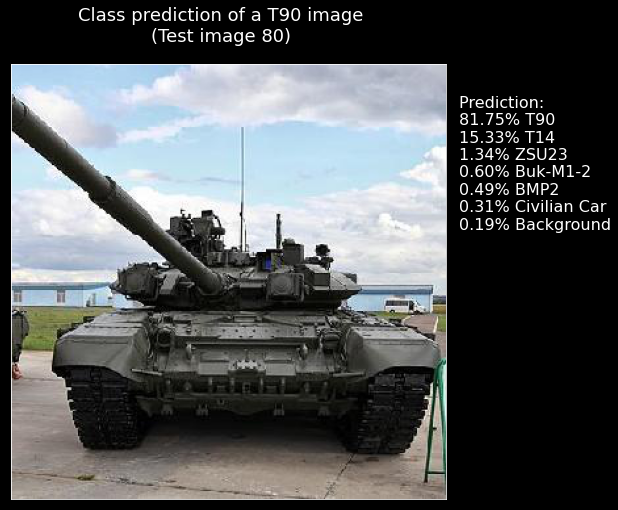


 Image 81 : [(76.5, 'T90'), (12.93, 'T14'), (5.07, 'BMP2'), (3.42, 'ZSU23'), (1.41, 'Buk-M1-2'), (0.45, 'Civilian Car'), (0.21, 'Background')]


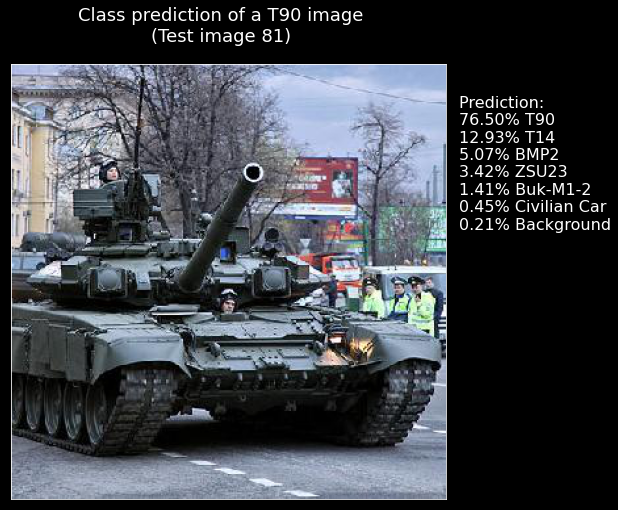


 Image 82 : [(47.48, 'T90'), (45.28, 'BMP2'), (3.96, 'T14'), (2.32, 'ZSU23'), (0.42, 'Civilian Car'), (0.33, 'Buk-M1-2'), (0.21, 'Background')]


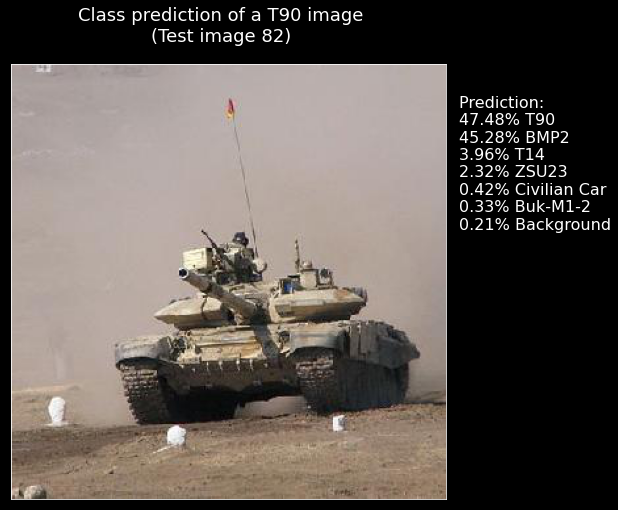


 Image 83 : [(95.0, 'T90'), (3.31, 'T14'), (1.25, 'BMP2'), (0.17, 'ZSU23'), (0.15, 'Buk-M1-2'), (0.06, 'Background'), (0.05, 'Civilian Car')]


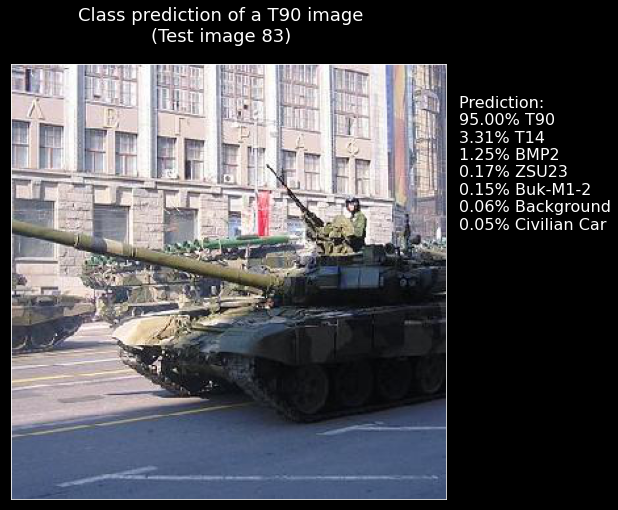


 Image 84 : [(95.26, 'T90'), (2.23, 'T14'), (1.49, 'ZSU23'), (0.6, 'BMP2'), (0.18, 'Buk-M1-2'), (0.13, 'Background'), (0.1, 'Civilian Car')]


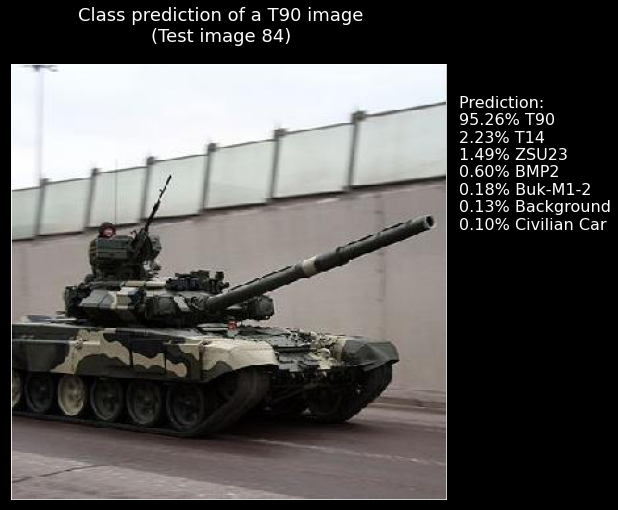


 Image 85 : [(86.02, 'T90'), (8.31, 'T14'), (3.15, 'ZSU23'), (1.32, 'BMP2'), (0.66, 'Buk-M1-2'), (0.42, 'Civilian Car'), (0.12, 'Background')]


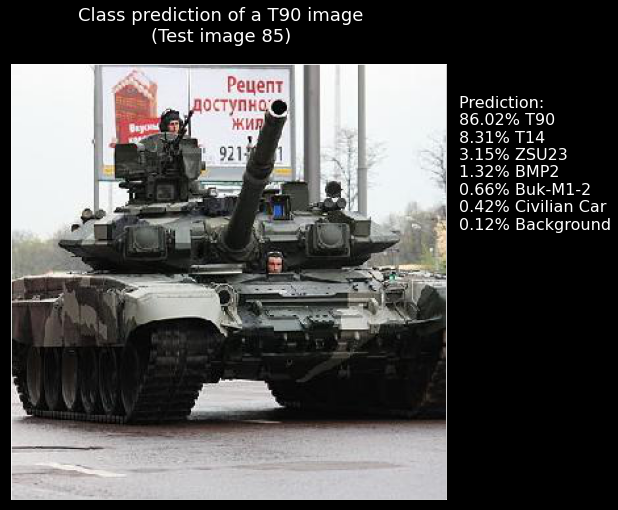


 Image 86 : [(84.18, 'T90'), (13.47, 'T14'), (0.89, 'BMP2'), (0.68, 'ZSU23'), (0.38, 'Buk-M1-2'), (0.27, 'Background'), (0.14, 'Civilian Car')]


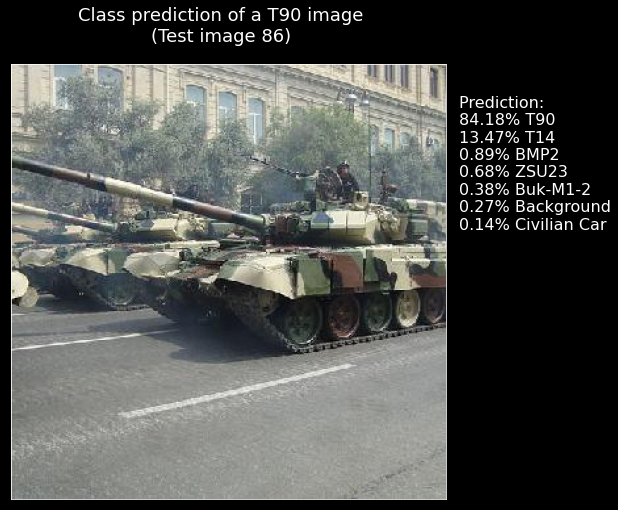


 Image 87 : [(85.59, 'T90'), (11.02, 'ZSU23'), (1.24, 'T14'), (1.07, 'Buk-M1-2'), (0.68, 'BMP2'), (0.31, 'Civilian Car'), (0.08, 'Background')]


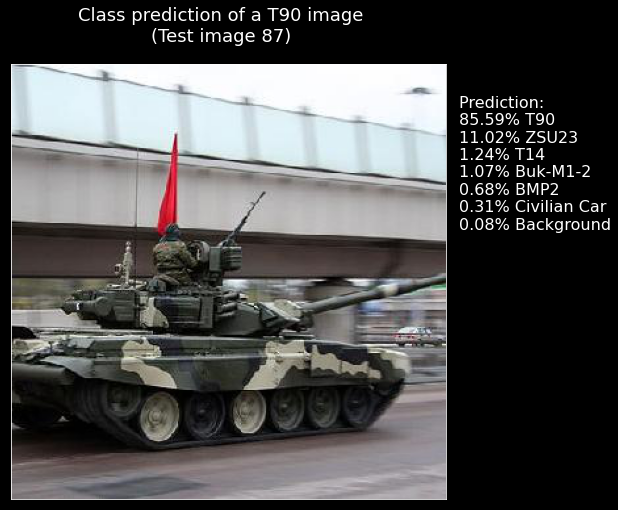


 Image 88 : [(88.44, 'T90'), (4.96, 'ZSU23'), (4.43, 'T14'), (0.98, 'BMP2'), (0.8, 'Buk-M1-2'), (0.28, 'Civilian Car'), (0.1, 'Background')]


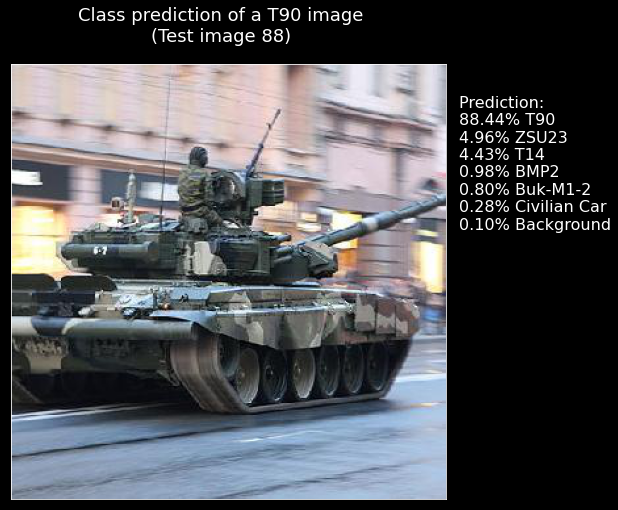


 Image 89 : [(89.18, 'T90'), (8.3, 'T14'), (0.8, 'ZSU23'), (0.72, 'BMP2'), (0.57, 'Buk-M1-2'), (0.22, 'Background'), (0.21, 'Civilian Car')]


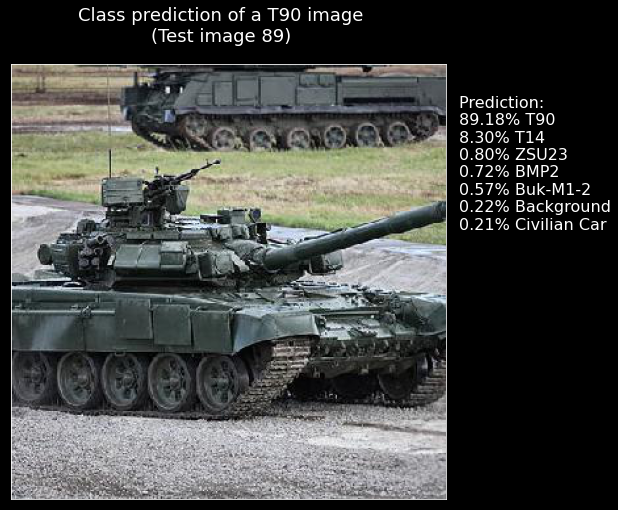


 Image 90 : [(87.07, 'T90'), (6.37, 'ZSU23'), (3.54, 'T14'), (1.75, 'BMP2'), (0.86, 'Buk-M1-2'), (0.24, 'Civilian Car'), (0.19, 'Background')]


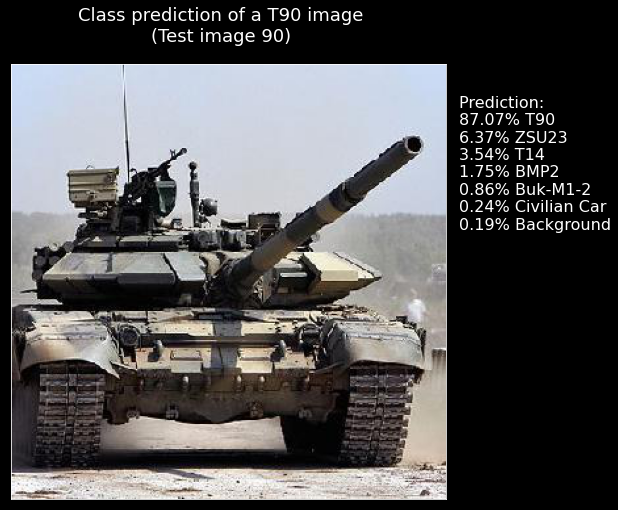


 Image 91 : [(98.61, 'ZSU23'), (1.06, 'T90'), (0.18, 'Buk-M1-2'), (0.06, 'BMP2'), (0.04, 'T14'), (0.03, 'Civilian Car'), (0.01, 'Background')]


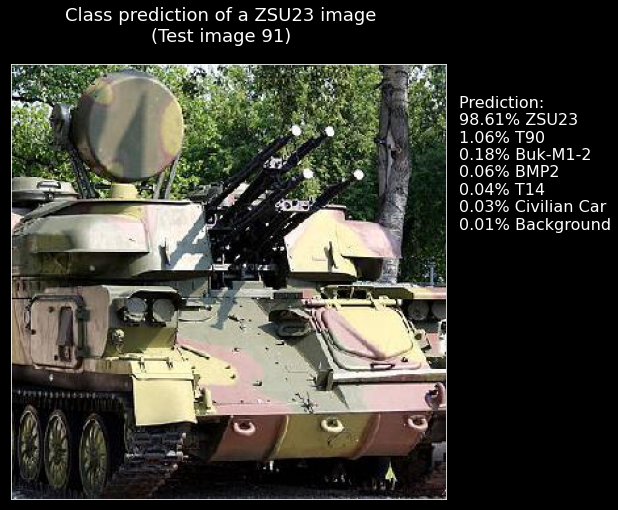


 Image 92 : [(89.62, 'ZSU23'), (9.33, 'T90'), (0.59, 'BMP2'), (0.2, 'Buk-M1-2'), (0.11, 'Civilian Car'), (0.1, 'T14'), (0.04, 'Background')]


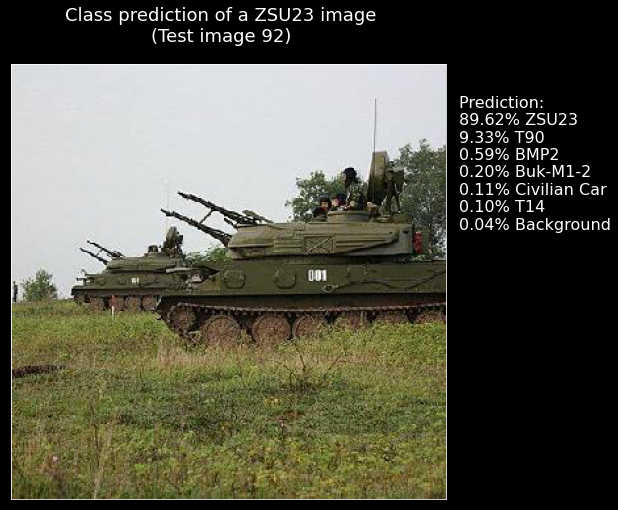


 Image 93 : [(96.74, 'ZSU23'), (1.58, 'T90'), (0.9, 'BMP2'), (0.53, 'T14'), (0.13, 'Civilian Car'), (0.07, 'Buk-M1-2'), (0.05, 'Background')]


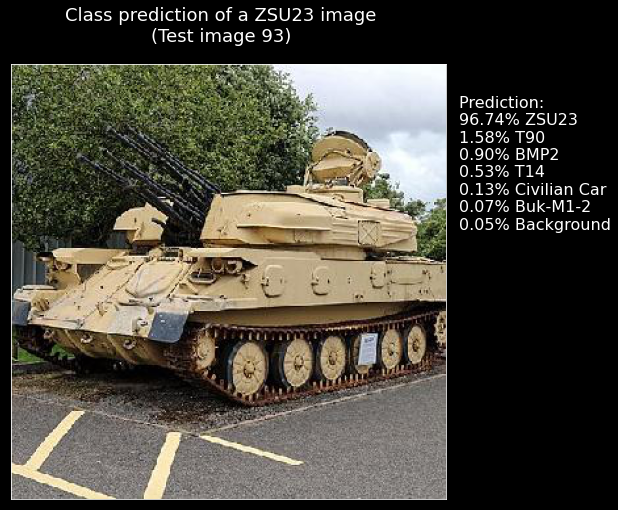


 Image 94 : [(97.23, 'ZSU23'), (2.34, 'T90'), (0.13, 'Buk-M1-2'), (0.1, 'T14'), (0.09, 'Civilian Car'), (0.09, 'BMP2'), (0.01, 'Background')]


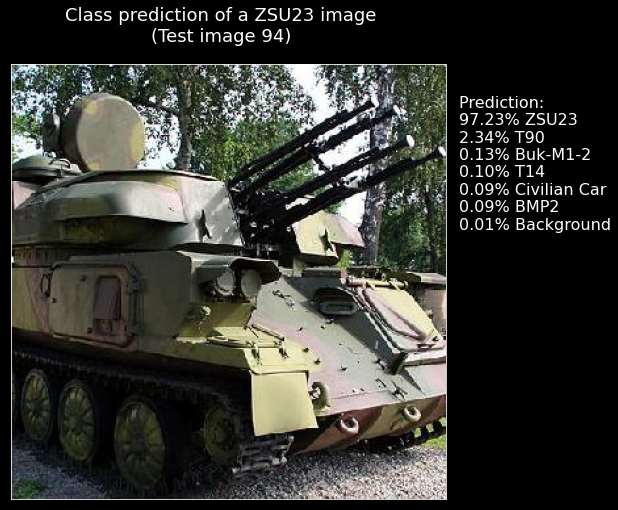


 Image 95 : [(96.15, 'ZSU23'), (2.07, 'T90'), (1.37, 'BMP2'), (0.22, 'T14'), (0.08, 'Civilian Car'), (0.07, 'Buk-M1-2'), (0.03, 'Background')]


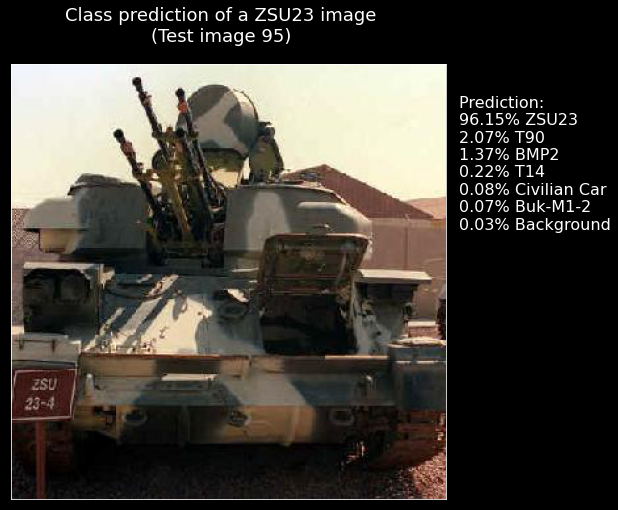


 Image 96 : [(86.05, 'ZSU23'), (5.3, 'BMP2'), (4.29, 'T90'), (2.48, 'Buk-M1-2'), (1.23, 'T14'), (0.34, 'Background'), (0.32, 'Civilian Car')]


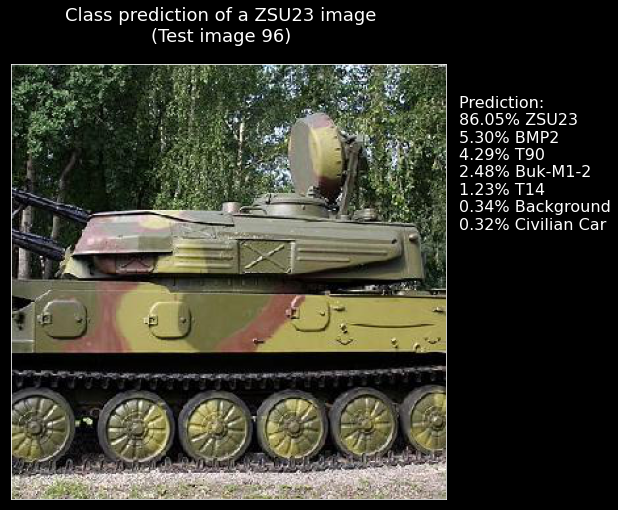


 Image 97 : [(56.24, 'ZSU23'), (25.86, 'Buk-M1-2'), (16.23, 'T90'), (0.97, 'T14'), (0.54, 'Civilian Car'), (0.1, 'BMP2'), (0.06, 'Background')]


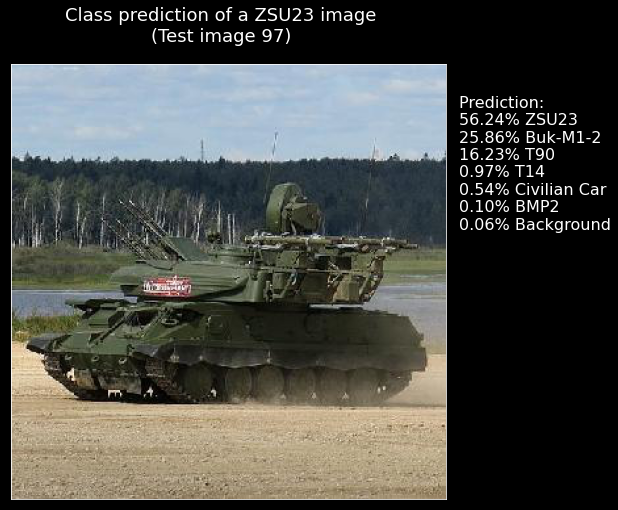


 Image 98 : [(93.85, 'ZSU23'), (5.36, 'BMP2'), (0.27, 'T90'), (0.19, 'Buk-M1-2'), (0.18, 'Civilian Car'), (0.09, 'T14'), (0.06, 'Background')]


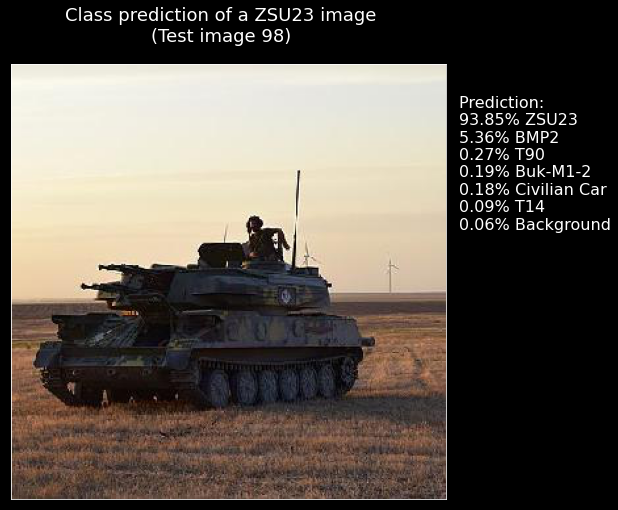


 Image 99 : [(98.06, 'ZSU23'), (0.93, 'T14'), (0.69, 'BMP2'), (0.12, 'Buk-M1-2'), (0.1, 'Background'), (0.05, 'Civilian Car'), (0.04, 'T90')]


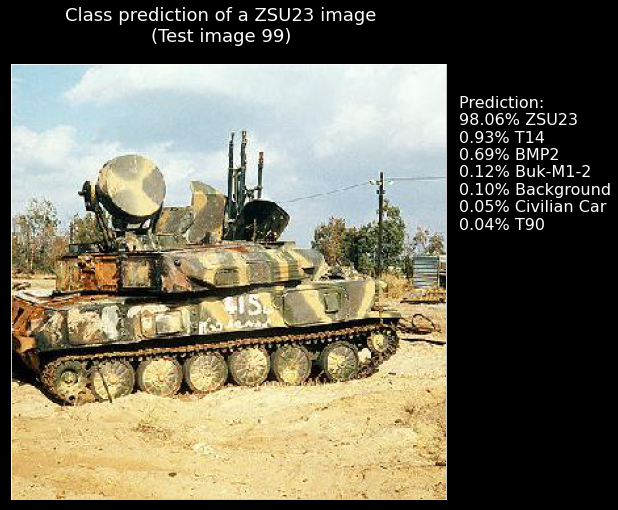


 Image 100 : [(49.26, 'T90'), (31.68, 'Buk-M1-2'), (14.27, 'ZSU23'), (2.39, 'T14'), (1.56, 'BMP2'), (0.71, 'Civilian Car'), (0.13, 'Background')]


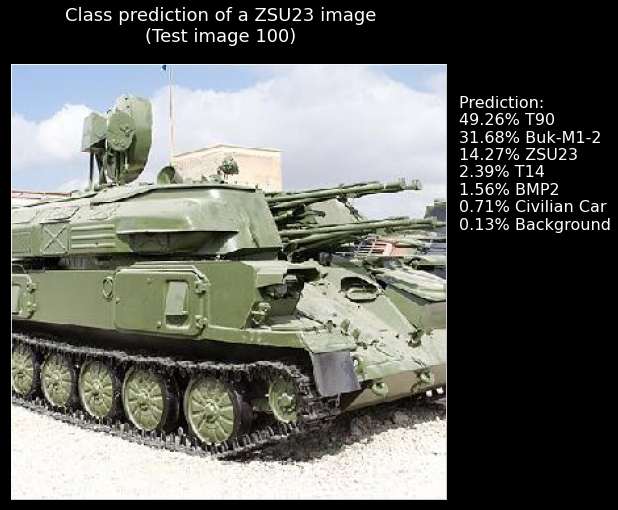


 Image 101 : [(85.05, 'ZSU23'), (12.94, 'T90'), (1.11, 'BMP2'), (0.38, 'Civilian Car'), (0.29, 'Buk-M1-2'), (0.19, 'T14'), (0.04, 'Background')]


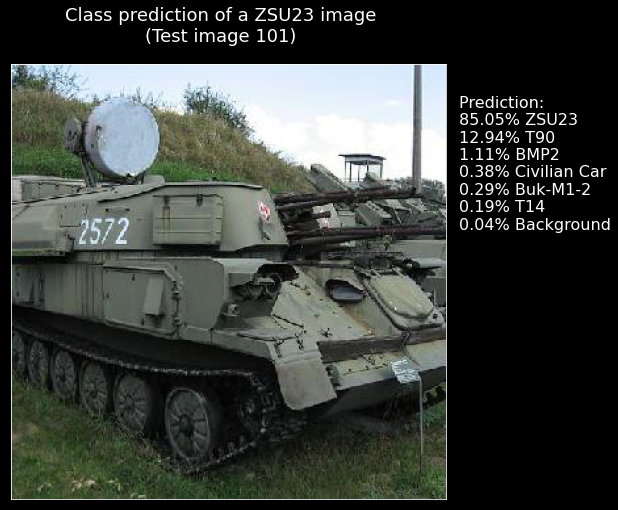


 Image 102 : [(94.55, 'ZSU23'), (3.9, 'T90'), (0.75, 'BMP2'), (0.48, 'T14'), (0.14, 'Civilian Car'), (0.14, 'Buk-M1-2'), (0.03, 'Background')]


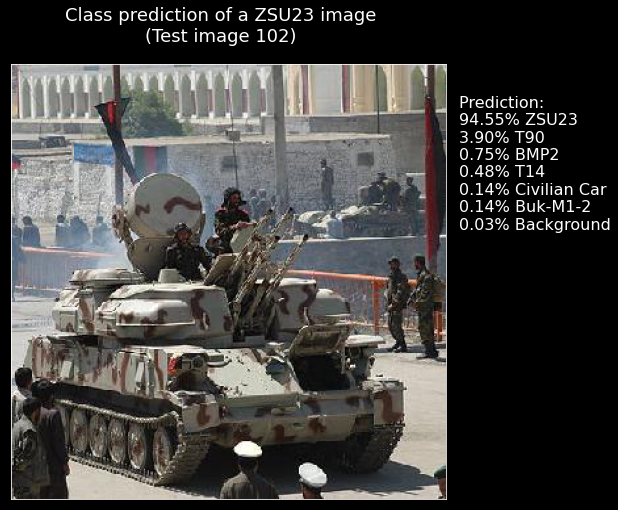


 Image 103 : [(98.93, 'ZSU23'), (0.33, 'BMP2'), (0.27, 'T14'), (0.16, 'Buk-M1-2'), (0.13, 'Civilian Car'), (0.1, 'Background'), (0.09, 'T90')]


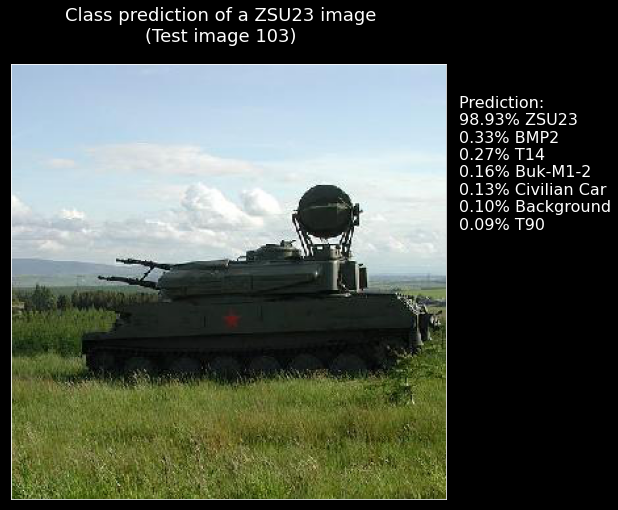


 Image 104 : [(97.37, 'ZSU23'), (1.52, 'T14'), (0.49, 'Civilian Car'), (0.27, 'T90'), (0.22, 'Buk-M1-2'), (0.1, 'BMP2'), (0.03, 'Background')]


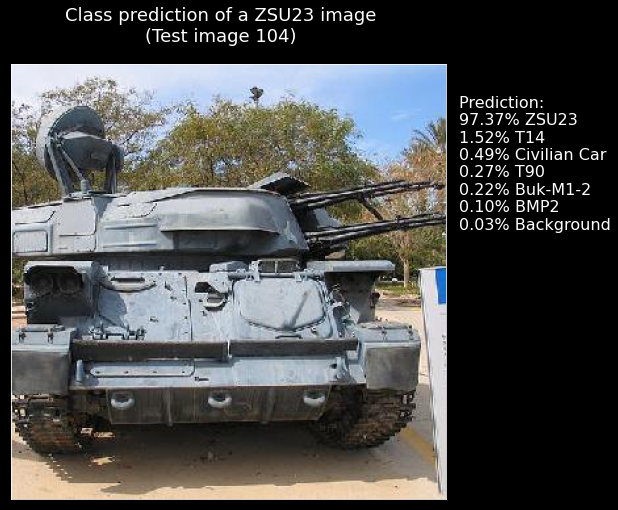


 Image 105 : [(82.46, 'ZSU23'), (13.74, 'T90'), (1.16, 'Buk-M1-2'), (1.04, 'BMP2'), (0.89, 'Civilian Car'), (0.65, 'T14'), (0.07, 'Background')]


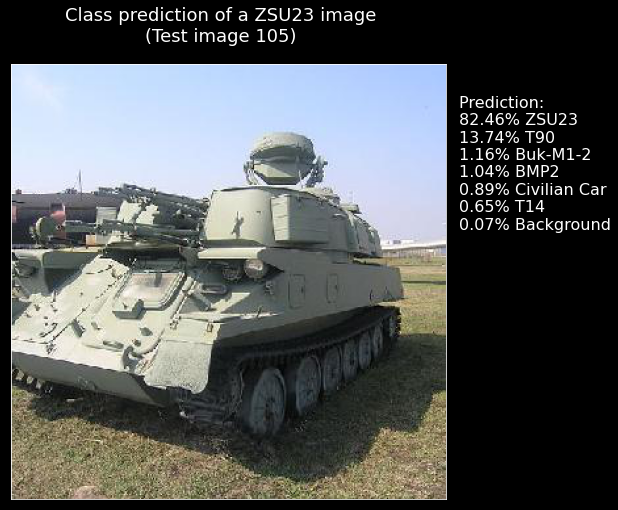

In [ ]:
print("\nClass Predictions of test images from", dataset_path +'test/')
for k in range(len(test_images_path)):
    predictions = []
    for l in range(len(classnames)):
        predictions.append((np.round(pred_labels[k][0][l] * 100, 2), classnames[l]))
    predictions.sort(reverse=True)
    print('\n',"Image", k + 1, ":", predictions)

    plt.figure(figsize=(8, 8))  # width, height in inches.
    plt.style.use('dark_background')
    plt.suptitle("Class prediction of a " + true_labels_class[k] + " image" + "\n(Test image " + str(k + 1) + ")", fontsize=18)
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    legend_string = "Prediction: " + \
                    "\n%.2f" % predictions[0][0] + "% " + predictions[0][1] + \
                    "\n%.2f" % predictions[1][0] + "% " + predictions[1][1] + \
                    "\n%.2f" % predictions[2][0] + "% " + predictions[2][1] + \
                    "\n%.2f" % predictions[3][0] + "% " + predictions[3][1] + \
                    "\n%.2f" % predictions[4][0] + "% " + predictions[4][1] + \
                    "\n%.2f" % predictions[5][0] + "% " + predictions[5][1] + \
                    "\n%.2f" % predictions[6][0] + "% " + predictions[6][1]
    plt.text(img_width + 10, 125, legend_string, fontsize=16)
    plt.imshow(mpimg.imread(test_images_path[k]))
    plt.show()

# Upload a new test image here to check how it is classified.

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving armor-4118213_1920.jpg to armor-4118213_1920.jpg


Plotting the new test image with class prediction

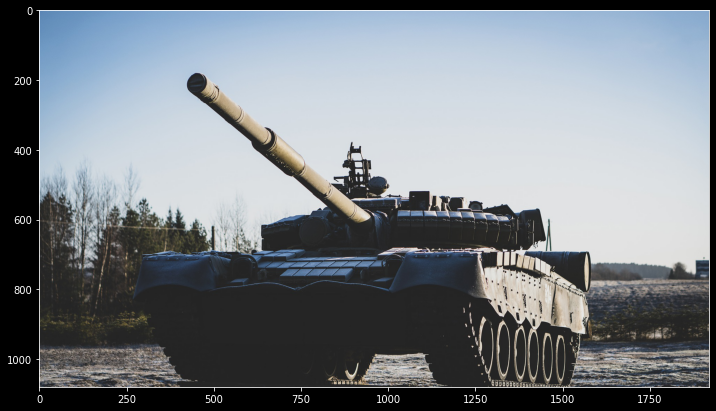

[[0.00815639 0.21709521 0.04386647 0.00895733 0.6048205  0.10770603
  0.00939801]]
predicted class for image armor-4118213_1920.jpg : T14 with 60.48% accuracy


In [ ]:
file = 'armor-4118213_1920.jpg' # https://pixabay.com/de/photos/r%C3%BCstung-r%C3%BCstung-schild-gepanzerte-4118213/
img = mpimg.imread(file)
plt.figure(figsize=(12, 12))
plt.imshow(img)
plt.show()

# making predection for new images
img = tf.keras.preprocessing.image.load_img(file, target_size=(img_height, img_width))
img_tensor = tf.keras.preprocessing.image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
img_tensor = efn.preprocess_input(img_tensor)
prediction = saved_model.predict(img_tensor)

print(prediction)
if np.argmax(prediction) == 0:
    print("predicted class for image", file, ": " + classnames[0] + " with " + str(np.round(prediction[0][0] * 100, 2)) + "% accuracy")
if np.argmax(prediction) == 1:
    print("predicted class for image", file, ": " + classnames[1] + " with " + str(np.round(prediction[0][1] * 100, 2)) + "% accuracy")
if np.argmax(prediction) == 2:
    print("predicted class for image", file, ": " + classnames[2] + " with " + str(np.round(prediction[0][2] * 100, 2)) + "% accuracy")
if np.argmax(prediction) == 3:
    print("predicted class for image", file, ": " + classnames[3] + " with " + str(np.round(prediction[0][3] * 100, 2)) + "% accuracy")
if np.argmax(prediction) == 4:
    print("predicted class for image", file, ": " + classnames[4] + " with " + str(np.round(prediction[0][4] * 100, 2)) + "% accuracy")
if np.argmax(prediction) == 5:
    print("predicted class for image", file, ": " + classnames[5] + " with " + str(np.round(prediction[0][5] * 100, 2)) + "% accuracy")
if np.argmax(prediction) == 6:
    print("predicted class for image", file, ": " + classnames[6] + " with " + str(np.round(prediction[0][6] * 100, 2)) + "% accuracy")